琼脂垫线性梯度的统计分析

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
import matplotlib as mpl
import os
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.ticker as ticker
import csv
import seaborn as sns
import CTX_Analysis_Functions as CAF
import scipy.stats as stats
from scipy.stats import shapiro
import statsmodels.stats.api as sms
from scipy.stats import kstest
from scipy.stats import kruskal
import scikit_posthocs as sp
import itertools
from matplotlib.ticker import MaxNLocator
from functools import partial

In [2]:
def concat_csv_output(df,p_f,filename, del_untitle = True, del_index=True):
    # 将同一批数据提前合并后输出
    if del_untitle:
        df = df.loc[:, ~df.columns.str.contains('^Unnamed')]
    if del_index:
        df.drop(columns='index')
    print(df.columns)
    df.to_csv(os.path.join(p_f, filename), index=False)
    # 输出df方便查看内容
    return df

In [3]:
def Label_Pirouettes(df,t_crit=6.16, frame_rate = 20, frame_length = 0.025, min_agl_spd=None):
# 输入：已经分了turn的df, 包含所有id。t_crit(sec)，如果需要重新分turn可以输入min_agl_spd
# 注意输入的df中不能是不同组混合的，id必须独立

    t_f_crit = t_crit*frame_rate
    if min_agl_spd:
        df.drop('Event', axis=1)
        df.loc[:,'Event']=0
        df.loc[df.agl_speed >= min_agl_spd, 'Event']=1
        
    df.loc[:,'Pirouette']=df['Event']
    df_pirouette = pd.DataFrame({})
    for g_id, g_df in df.groupby('ID'):
        g_df = g_df.reset_index(drop=True)
        # nan值是计算速度和角速度时舍弃的点，默认是0不计算c
        event_vec = g_df.Event.fillna(0).values

        # 向后移动一位，上下相减
        diff_vec = event_vec[1:]-event_vec[:-1]
        if (diff_vec==0).all():
            pass
        elif ~(diff_vec==-1).any() or ~(diff_vec==1).any():
            print('turn只在开头结尾')
        else:
            # 统计所有出现1和-1的索引
            idx_1 = np.where(diff_vec == 1)[0]
            idx_n1 = np.where(diff_vec == -1)[0]
            if np.min(idx_1)<np.min(idx_n1):
                # 如果最小的索引是1而不是-1，说明开头是run，然后才开始出现turn
                if len(idx_1)>len(idx_n1):
                    # 如果1的数量大于-1,说明最后一个turn没有结束
#                     print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
                    # 去掉第一个1的索引，用1减去所有-1的索引，判断长度
                    run_lens_btw_turns = idx_1[1:]-idx_n1
                    for i,r in enumerate(run_lens_btw_turns):
                        if r <= t_f_crit:
                            low_b = idx_n1[i]+1
                            upper_b = idx_1[i+1]+1      # 注意idx_1去头，所以索引内加以
                            g_df.loc[low_b:upper_b, 'Pirouette']=1

                elif len(idx_1)==len(idx_n1):
                    # 如果两者数量相同，说明最后以run结尾，这条轨迹前后是完整的多个turn
#                     print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
                    # 去掉1的所索引的首部和-1的尾部，用1减去-1的索引判断长度
                    run_lens_btw_turns = idx_1[1:]-idx_n1[:-1]
                    for i,r in enumerate(run_lens_btw_turns):
                        if r <= t_f_crit:
                            low_b = idx_n1[i]+1
                            upper_b = idx_1[i+1]+1
                            g_df.loc[low_b:upper_b, 'Pirouette']=1

                # 无论是上述哪种情况，turn的数量都记为出现1的数量
                num_turn = len(idx_1)
#                 print(f'Turn number: {num_turn}')
            elif np.min(idx_1)>np.min(idx_n1):
                # 如果最小索引是-1而不是1，说明开头就是turn
                if (len(idx_n1)== len(idx_1)+1):
                    # 如果-1比1多一个，说明以run结尾
#                     print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
                    # 去掉最后一个-1的索引，用1减去-1
                    run_lens_btw_turns = idx_1-idx_n1[:-1]
                    for i,r in enumerate(run_lens_btw_turns):
                        if r <= t_f_crit:
                            low_b = idx_n1[i]+1
                            upper_b = idx_1[i]+1
                            g_df.loc[low_b:upper_b, 'Pirouette']=1
                elif (len(idx_n1) == len(idx_1)):
                    # 如果-1和1一样多，说明以turn结尾
#                     print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
                    # 直接用1的索引减去-1
                    run_lens_btw_turns = idx_1-idx_n1
                    for i,r in enumerate(run_lens_btw_turns):
                        if r <= t_f_crit:
                            low_b = idx_n1[i]+1
                            upper_b = idx_1[i]+1
                            g_df.loc[low_b:upper_b, 'Pirouette']=1
        df_pirouette = pd.concat([df_pirouette, g_df], axis=0, ignore_index=True)


    return df_pirouette

In [4]:
def Label_Pirouettes_by_id(g_df,t_crit=6.16, frame_rate = 20, frame_length = 0.025, min_agl_spd=None):
# 输入：同一个id的df, t_crit(sec)，如果需要重新分turn可以输入min_agl_spd
# 注意输入的df中不能是不同组混合的，id必须独立
    t_f_crit = t_crit*frame_rate
    if min_agl_spd:
        g_df.drop('Event', axis=1)
        g_df.loc[:,'Event']=0
        g_df.loc[df.agl_speed >= min_agl_spd, 'Event']=1
        
    g_df.loc[:,'Pirouette']=df['Event']
    g_df = g_df.reset_index()
    # nan值是计算速度和角速度时舍弃的点，默认是0不计算c
    event_vec = g_df.Event.fillna(0).values

    # 向后移动一位，上下相减
    diff_vec = event_vec[1:]-event_vec[:-1]
    if (diff_vec==0).all():
        pass
    elif ~(diff_vec==-1).any() or ~(diff_vec==1).any():
        print('只有结尾有turn或只有开头有turn')
    else:
        # 统计所有出现1和-1的索引
        idx_1 = np.where(diff_vec == 1)[0]
        idx_n1 = np.where(diff_vec == -1)[0]
        if np.min(idx_1)<np.min(idx_n1):
            # 如果最小的索引是1而不是-1，说明开头是run，然后才开始出现turn
            if len(idx_1)>len(idx_n1):
                # 如果1的数量大于-1,说明最后一个turn没有结束
#                 print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
                # 去掉第一个1的索引，用1减去所有-1的索引，判断长度
                run_lens_btw_turns = idx_1[1:]-idx_n1
                for i,r in enumerate(run_lens_btw_turns):
                    if r <= t_f_crit:
                        low_b = idx_n1[i]+1
                        upper_b = idx_1[i+1]+1      # 注意idx_1去头，所以索引内加以
                        g_df.loc[low_b:upper_b, 'Pirouette']=1

            elif len(idx_1)==len(idx_n1):
                # 如果两者数量相同，说明最后以run结尾，这条轨迹前后是完整的多个turn
#                 print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
                # 去掉1的所索引的首部和-1的尾部，用1减去-1的索引判断长度
                run_lens_btw_turns = idx_1[1:]-idx_n1[:-1]
                for i,r in enumerate(run_lens_btw_turns):
                    if r <= t_f_crit:
                        low_b = idx_n1[i]+1
                        upper_b = idx_1[i+1]+1
                        g_df.loc[low_b:upper_b, 'Pirouette']=1

            # 无论是上述哪种情况，turn的数量都记为出现1的数量
            num_turn = len(idx_1)
#             print(f'Turn number: {num_turn}')
        elif np.min(idx_1)>np.min(idx_n1):
            # 如果最小索引是-1而不是1，说明开头就是turn
            if (len(idx_n1)== len(idx_1)+1):
                # 如果-1比1多一个，说明以run结尾
#                 print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
                # 去掉最后一个-1的索引，用1减去-1
                run_lens_btw_turns = idx_1-idx_n1[:-1]
                for i,r in enumerate(run_lens_btw_turns):
                    if r <= t_f_crit:
                        low_b = idx_n1[i]+1
                        upper_b = idx_1[i]+1
                        g_df.loc[low_b:upper_b, 'Pirouette']=1
            elif (len(idx_n1) == len(idx_1)):
                # 如果-1和1一样多，说明以turn结尾
#                 print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
                # 直接用1的索引减去-1
                run_lens_btw_turns = idx_1-idx_n1
                for i,r in enumerate(run_lens_btw_turns):
                    if r <= t_f_crit:
                        low_b = idx_n1[i]+1
                        upper_b = idx_1[i]+1
                        g_df.loc[low_b:upper_b, 'Pirouette']=1
    return g_df

In [5]:
p_f = [r'Z:\data space+\C. elegans chemotaxis\20241203\for_analysis']
df_1203,conds_1203=CAF.get_comb_csv_and_conds(p_f, t_inv_draw=5,key_word_1='smh-als.csv',plate_type = 1, cut = 1, x_cut = 2, y_cut=2)
df_1203 = df_1203[df_1203.speed != 0]

共13个文件
20241203_CTX-on-Pad_3gNaPre_0gNa-Plate-1.5agar_3_smh-als.csv,edited at Thu Dec  5 19:00:48 2024 

20241203_CTX-on-Pad_3gNaPre_0gNa-Plate-1.7agar_1_smh-als.csv,edited at Thu Dec  5 19:01:34 2024 

20241203_CTX-on-Pad_3gNaPre_0gNa-Plate-1.7agar_2_smh-als.csv,edited at Thu Dec  5 19:02:12 2024 

20241203_CTX-on-Pad_3gNaPre_0gNa-Plate-2agar_2_smh-als.csv,edited at Thu Dec  5 19:03:18 2024 

20241203_CTX-on-Pad_3gNaPre_4.5gNa-Plate-1.5agar_1_smh-als.csv,edited at Thu Dec  5 19:04:16 2024 

20241203_CTX-on-Pad_3gNaPre_4.5gNa-Plate-1.5agar_2_smh-als.csv,edited at Thu Dec  5 19:05:11 2024 

20241203_CTX-on-Pad_3gNaPre_4.5gNa-Plate-1.5agar_3_smh-als.csv,edited at Thu Dec  5 19:06:07 2024 

20241203_CTX-on-Pad_3gNaPre_4.5gNa-Plate-1.7agar_1_smh-als.csv,edited at Thu Dec  5 13:27:14 2024 

20241203_CTX-on-Pad_3gNaPre_4.5gNa-Plate-1.7agar_2_smh-als.csv,edited at Thu Dec  5 19:09:48 2024 

20241203_CTX-on-Pad_3gNaPre_4.5gNa-Plate-1.7agar_3_smh-als.csv,edited at Thu Dec  5 20:24:24 2024 

202

In [6]:
df_1203.groupby('Condition')['Group_id'].unique()

Condition
0gNa-Plate-1.5agar            [3]
0gNa-Plate-1.7agar         [1, 2]
0gNa-Plate-2agar              [2]
4.5gNa-Plate-1.5agar    [1, 2, 3]
4.5gNa-Plate-1.7agar    [1, 2, 3]
4.5gNa-Plate-2agar         [2, 3]
Name: Group_id, dtype: object

In [5]:
p_f = [r'Z:\data space+\C. elegans chemotaxis\20241213\smh_als\he']
df_1213,conds_1213=CAF.get_comb_csv_and_conds(p_f, t_inv_draw=5,key_word_1='smh-als.csv',plate_type = 1, cut = 1, x_cut = 2, y_cut=2)
df_1213 = df_1213[df_1213.speed != 0]

共9个文件
20241213_CTX-on-Pad_ov-24hd-he_0gNa(0gNa)_1_smh-als.csv,edited at Sat Dec 14 13:30:31 2024 

20241213_CTX-on-Pad_ov-24hd-he_0gNa(0gNa)_2_smh-als.csv,edited at Sat Dec 14 14:32:50 2024 

20241213_CTX-on-Pad_ov-24hd-he_0gNa(0gNa)_3_smh-als.csv,edited at Sat Dec 14 13:31:51 2024 

20241213_CTX-on-Pad_ov-24hd-he_0gNa(3gNa)_1_smh-als.csv,edited at Sat Dec 14 14:34:22 2024 

20241213_CTX-on-Pad_ov-24hd-he_0gNa(3gNa)_2_smh-als.csv,edited at Sat Dec 14 14:35:45 2024 

20241213_CTX-on-Pad_ov-24hd-he_4.5gNa(0gNa)_1_smh-als.csv,edited at Sat Dec 14 14:36:31 2024 

20241213_CTX-on-Pad_ov-24hd-he_4.5gNa(0gNa)_3_smh-als.csv,edited at Sat Dec 14 13:14:42 2024 

20241213_CTX-on-Pad_ov-24hd-he_4.5gNa(3gNa)_2_smh-als.csv,edited at Sat Dec 14 13:16:02 2024 

20241213_CTX-on-Pad_ov-24hd-he_4.5gNa(3gNa)_3_smh-als.csv,edited at Sat Dec 14 13:17:18 2024 

裁剪的像素距离为：X 80.0， Y 80.0
原X,Y距离范围分别为 [1336.0618009170432, 2545.859937015025] [966.0396388876154, 2247.335286754645]
裁剪后距离范围分别为 [1416.0618009170432, 24

In [29]:
p_f = [r'Z:\data space+\C. elegans chemotaxis\20241213\smh_als\he', r'Z:\data space+\C. elegans chemotaxis\20241213\smh_als\li']
df_1213_all,conds_1213_all=CAF.get_comb_csv_and_conds(p_f, t_inv_draw=5,key_word_1='smh-als.csv',plate_type = 1, cut = 1, x_cut = 2, y_cut=2)
df_1213_all = df_1213_all[df_1213_all.speed != 0]

共17个文件
20241213_CTX-on-Pad_ov-24hd-he_0gNa(0gNa)_1_smh-als.csv,edited at Sat Dec 14 13:30:31 2024 

20241213_CTX-on-Pad_ov-24hd-he_0gNa(0gNa)_2_smh-als.csv,edited at Sat Dec 14 14:32:50 2024 

20241213_CTX-on-Pad_ov-24hd-he_0gNa(0gNa)_3_smh-als.csv,edited at Sat Dec 14 13:31:51 2024 

20241213_CTX-on-Pad_ov-24hd-he_0gNa(3gNa)_1_smh-als.csv,edited at Sat Dec 14 14:34:22 2024 

20241213_CTX-on-Pad_ov-24hd-he_0gNa(3gNa)_2_smh-als.csv,edited at Sat Dec 14 14:35:45 2024 

20241213_CTX-on-Pad_ov-24hd-he_4.5gNa(0gNa)_1_smh-als.csv,edited at Sat Dec 14 14:36:31 2024 

20241213_CTX-on-Pad_ov-24hd-he_4.5gNa(0gNa)_3_smh-als.csv,edited at Sat Dec 14 13:14:42 2024 

20241213_CTX-on-Pad_ov-24hd-he_4.5gNa(3gNa)_2_smh-als.csv,edited at Sat Dec 14 13:16:02 2024 

20241213_CTX-on-Pad_ov-24hd-he_4.5gNa(3gNa)_3_smh-als.csv,edited at Sat Dec 14 13:17:18 2024 

20241213_CTX-on-Pad_ov-24hd-li_0gNa(0gNa)_1_smh-als.csv,edited at Sat Dec 14 13:33:03 2024 

20241213_CTX-on-Pad_ov-24hd-li_0gNa(0gNa)_2_smh-als.csv

In [7]:
p_f = [r'Z:\data space+\C. elegans chemotaxis\20241213\smh_als\li']
df_1213_li,conds_1213_li=CAF.get_comb_csv_and_conds(p_f, t_inv_draw=5,key_word_1='smh-als.csv',plate_type = 1, cut = 1, x_cut = 2, y_cut=2)
df_1213_li = df_1213_li[df_1213_li.speed != 0]

共8个文件
20241213_CTX-on-Pad_ov-24hd-li_0gNa(0gNa)_1_smh-als.csv,edited at Sat Dec 14 13:33:03 2024 

20241213_CTX-on-Pad_ov-24hd-li_0gNa(0gNa)_2_smh-als.csv,edited at Sat Dec 14 13:34:21 2024 

20241213_CTX-on-Pad_ov-24hd-li_0gNa(3gNa)_1_smh-als.csv,edited at Sat Dec 14 13:19:39 2024 

20241213_CTX-on-Pad_ov-24hd-li_0gNa(3gNa)_2_smh-als.csv,edited at Sat Dec 14 13:22:10 2024 

20241213_CTX-on-Pad_ov-24hd-li_4.5gNa(0gNa)_1_smh-als.csv,edited at Sat Dec 14 13:35:26 2024 

20241213_CTX-on-Pad_ov-24hd-li_4.5gNa(0gNa)_2_smh-als.csv,edited at Sat Dec 14 13:24:42 2024 

20241213_CTX-on-Pad_ov-24hd-li_4.5gNa(3gNa)_1_smh-als.csv,edited at Sat Dec 14 13:27:10 2024 

20241213_CTX-on-Pad_ov-24hd-li_4.5gNa(3gNa)_2_smh-als.csv,edited at Sat Dec 14 13:28:57 2024 

裁剪的像素距离为：X 80.0， Y 80.0
原X,Y距离范围分别为 [1306.5626571256475, 2342.7718861555327] [826.0198021759932, 2187.956823950716]
裁剪后距离范围分别为 [1386.5626571256475, 2262.7718861555327] [906.0198021759932, 2107.956823950716]
裁剪的像素距离为：X 80.0， Y 80.0
原X,Y距离范围分别为

### Combine data

# (Newly developed) 初步分析代码

In [6]:
new_folder = 0

In [30]:
new_folder =r'Z:\data space+\C. elegans chemotaxis\20241213\smh_als\fig'

 作图的代码开发完成后可以整合进LCAF中

In [8]:
# # 修改
# path = r'Z:\data space+\C. elegans chemotaxis\20241203\for_analysis'
# f_n = '20241203_CTX-on-Pad_3gNaPre_4.5gNa-Plate_1.7agar_3_smh-als.csv'
# df_r = pd.read_csv(os.path.join(path, f_n))
# df_r.loc[:,'Condition'] = '4.5gNa-Plate-1.7agar'
# r_name = '20241203_CTX-on-Pad_3gNaPre_4.5gNa-Plate-1.7agar_3_smh-als.csv'
# df_r.to_csv(os.path.join(path, r_name))

### Tuning rate计算

### 速度角速度随时间变化（between conditions）

比较每个condition内的所有数据的速度和角速度

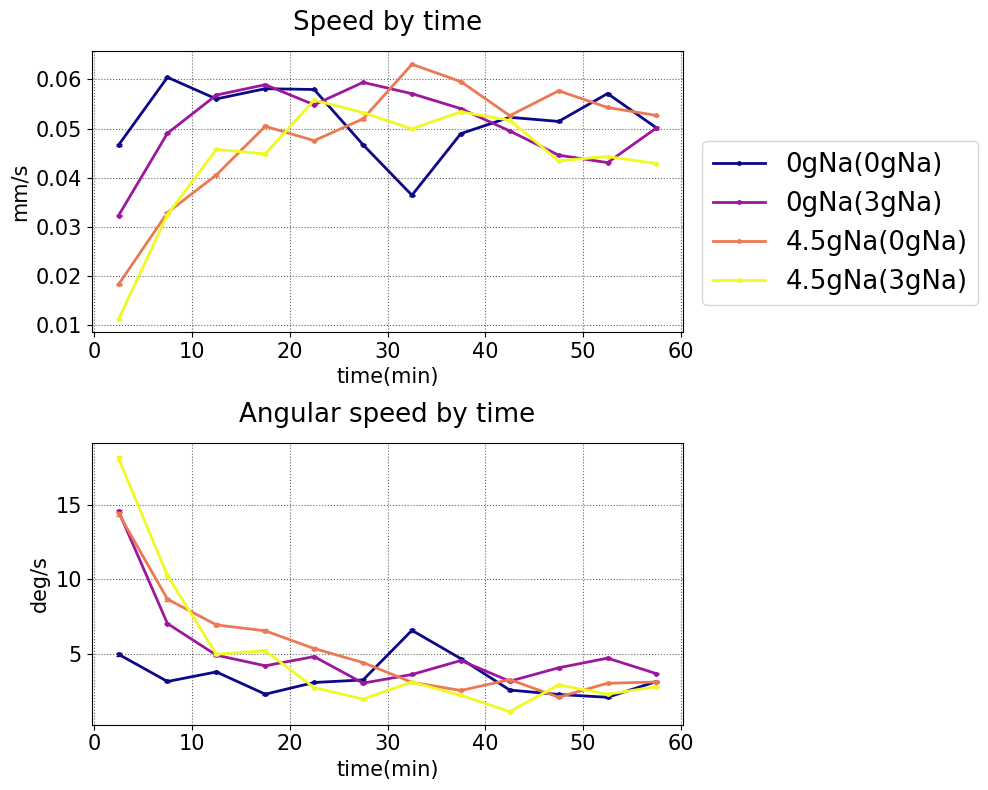

In [11]:
# 速度角速度组间比较
fig_n = 2
fig,axes = plt.subplots(fig_n,1, figsize = (10,8))        # (7,6) or(6,8)
ax = axes.ravel()
ls = 15
fs = 15
lw = 2
angle = 45

spf_title = 'li_'

# 根据关键词筛选颜色
# key_1 = '0gNa-OP50'
key_1 = ''
# color_map = ['summer', 'autumn']
color_map = ['plasma']
conds = conds_1213_li
df_als_new = df_1213_li


# 不同的condition使用不同的颜色标记，并根据key映射不同colormap
colors_vec = [i for i in range(len(conds))]
color_vec_norm = colors_vec/np.max(colors_vec)
color_dict = {}
for i in range(len(conds)):
    if key_1 in conds[i]:
        clm = color_map[0]
    else:
        clm = color_map[1]
    colormap = mpl.colormaps[clm]
    colors  = colormap(color_vec_norm)
    color_dict[conds[i]] = colors[i]

for j in range(len(conds)):
    df_cond = df_als_new[df_als_new['Condition']==conds[j]]
    df_cond_run= df_cond[df_cond['Event']==0]                # 去掉了sharp turn 的数据
    
    # 根据时间段画出平均速度，平均角速率，距圆心距离，CTX的分布(柱状图)
    mean_gby_period = df_cond_run.groupby('Period_draw').agg({'agl_speed':'mean','speed':'mean', 'agl_speed':'mean'})
#         sum_gby_period = df_cond_run.groupby('Period_draw').agg({'speed':'sum','speed':'sum'})
    std_gb_period = df_cond_run.groupby('Period_draw').agg({'agl_speed':'sem','speed':'sem', 'agl_speed':'sem'})
    gb_period_count = df_cond_run.groupby('Period_draw').count()

#     # 距圆心平均位置
#     yerr_dist = std_gb_period['Dist_to_NaCl']/np.sqrt(gb_period_count['Dist_to_NaCl'])
#     ax[0].errorbar(mean_gby_period.index, mean_gby_period['Dist_to_NaCl']*pixel_length, yerr = yerr_dist,fmt = 'None', ecolor = color_dict[conds[j]], capsize = 2, linewidth = lw)
#     ax[0].plot(mean_gby_period.index, mean_gby_period['Dist_to_NaCl']*pixel_length, color = color_dict[conds[j]], marker = 'o',markersize = 2.5, label = str(conds[j]), linewidth = lw)

    # 速度
#     yerr_spd = std_gb_period['speed']/np.sqrt(gb_period_count['speed'])
    ax[0].errorbar(mean_gby_period.index, mean_gby_period['speed'], yerr = std_gb_period['speed'],fmt = 'None', ecolor = color_dict[conds[j]], capsize = 2, linewidth = lw)
    ax[0].plot(mean_gby_period.index, mean_gby_period['speed'], color = color_dict[conds[j]], marker = 'o',markersize = 2.5, label = str(conds[j]), linewidth = lw)

    # 角速度
#     yerr_spd = std_gb_period['agl_speed']/np.sqrt(gb_period_count['agl_speed'])
    ax[1].errorbar(mean_gby_period.index, mean_gby_period['agl_speed'], yerr = std_gb_period['agl_speed'],fmt = 'None', ecolor = color_dict[conds[j]], capsize = 2, linewidth = lw)
    ax[1].plot(mean_gby_period.index, mean_gby_period['agl_speed'], color = color_dict[conds[j]], marker = 'o',markersize = 2.5, label = str(conds[j]), linewidth = lw)


ax[0].set_title('Speed by time', fontsize = fs*1.25, pad = fs)
ax[0].grid(True,linestyle=':',color='black',alpha=0.6)
ax[0].set_xlabel('time(min)', fontsize = fs)
ax[0].set_ylabel('mm/s', fontsize = fs)
ax[0].legend(bbox_to_anchor = (1.01, 0.05),loc = 3,fontsize = fs*1.25, fancybox = True)
        # 设置图片刻度和字体大小
ax[0].tick_params(labelsize=ls)

ax[1].set_title('Angular speed by time', fontsize = fs*1.25, pad = fs)
ax[1].grid(True,linestyle=':',color='black',alpha=0.6)
ax[1].set_ylabel('deg/s', fontsize = fs)
ax[1].set_xlabel('time(min)', fontsize = fs)
# ax[1].legend(bbox_to_anchor = (1.01, 0.5),loc = 3,fontsize = fs*1.25, fancybox = True)
        # 设置图片刻度和字体大小
ax[1].tick_params(labelsize=ls)
plt.tight_layout()
if new_folder:
#  保存图片
    title_name = spf_title+'Agl_spd_t.png'
    file_path = os.path.join(new_folder, title_name)
    plt.savefig(file_path,bbox_inches='tight')
else:
    plt.show()

比较每个group（包括所有condition的所有重复组）之内的速度数据

In [68]:
labels

[6000.0, 18000.0, 30000.0, 42000.0, 54000.0, 66000.0]

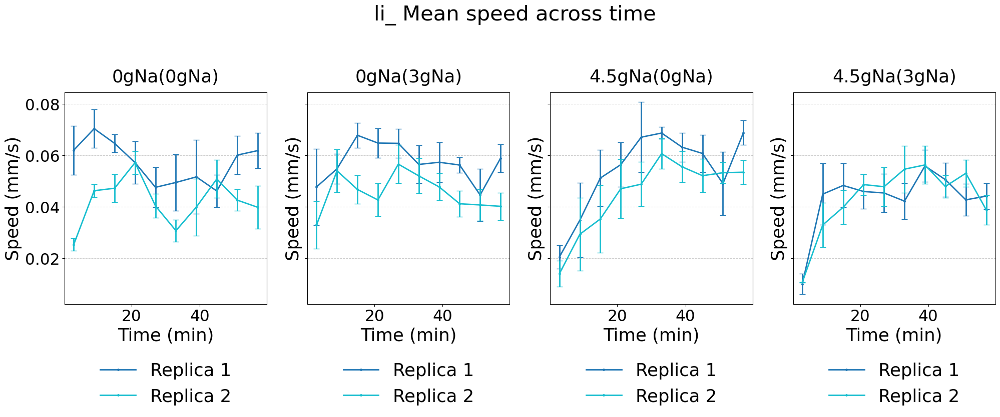

In [14]:
# 组间比较，每个子图为一个实验条件中各个replica的差异比较，每条数据线合并单个replica中的各个id的数据
conds = conds_1213_li
df = df_1213_li

# 配置参数
time_len = 1  # h
time_inv = 6  # min
frame_length = 0.025  # mm
frame_rate = 20
colormap = 'tab10'
spf_title = 'li_'
y_lim = []
fs, lw, ls, angle = 30, 2, 15, 45

# 时间间隔和标签
num_frames = time_len * 3600 * frame_rate
periods_timestamp = np.arange(0, num_frames + 1, time_inv * 60 * frame_rate)
periods = np.arange(0,time_len*60+1,time_inv)
labels = [(i + j) / 2 for i, j in zip(periods[:-1], periods[1:])]
df['Period_label'] = pd.cut(df['Timestamp'], bins=periods_timestamp, labels=labels, right=False, include_lowest=True)

# 绘制图形
fig, ax = plt.subplots(1, len(conds), figsize=(6 * len(conds), 5.5), sharey=True)
plt.suptitle(spf_title+' '+'Mean speed across time', fontsize=fs, y=1.2)

for n, cond in enumerate(conds):
    df_cond = df[df['Condition'] == cond]
    
    # 按时间区间和组聚合
    df_gp = (
        df_cond.groupby(['Group_id', 'Period_label', 'ID'])['speed']
        .mean().reset_index()
        .groupby(['Group_id', 'Period_label'])
        .agg(mean=('speed', 'mean'), sem=('speed', 'sem'))
        .reset_index()
    )
#     df_gp[['mean', 'sem']] *= frame_length

    # 分配颜色
    groups = df_gp['Group_id'].unique()
    cmap = mpl.colormaps[colormap](np.linspace(0, 1, len(groups)))
    colors = {group: cmap[i] for i, group in enumerate(groups)}

    for group, df_g in df_gp.groupby('Group_id'):
        # 剔除含 NaN 的数据点
        df_g = df_g[df_g['mean'].notna()]
        
        # 绘图
        ax[n].errorbar(df_g['Period_label'], df_g['mean'], yerr=df_g['sem'],
                       fmt='None', ecolor=colors[group], capsize=lw * 2, linewidth=lw)
        ax[n].plot(df_g['Period_label'], df_g['mean'], marker='o', markersize=2.5,
                   color=colors[group], label=f'Replica {group}', linewidth=lw)
    
    # 配置子图
    ax[n].set_title(cond, fontsize=fs * 0.85, pad=fs * 0.5)
    ax[n].set_xlabel('Time (min)', fontsize=fs * 0.85)
    ax[n].set_ylabel('Speed (mm/s)', fontsize=fs * 0.85)
    ax[n].grid(axis='y', linestyle='dashed', color='grey', alpha=0.4)
    ax[n].legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), fontsize=fs * 0.85, frameon=False)
    ax[n].tick_params(labelsize=fs * 0.75)

# 调整布局和保存/展示
plt.subplots_adjust(hspace=0.2, wspace=0.2)
if y_lim:
    plt.ylim(*y_lim)
if new_folder:
    plt.savefig(os.path.join(new_folder, spf_title+'Disp-Midl_btw_conds_groups.png'), bbox_inches='tight')
else:
    plt.show()


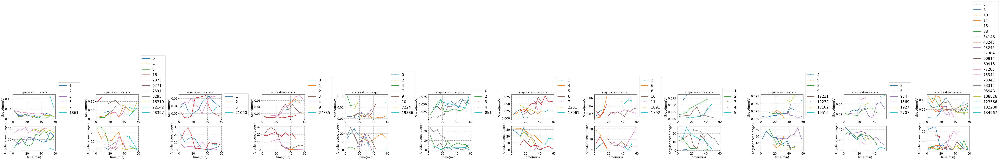

In [41]:
# 速度角速度组内比较，同一组内比较每个id的速度角速度随时间变化
# 每一个condition_replica-id为一列，图中每一条线为一个id，分配一组颜色
# 所有分组在一张图上
# 速度角速度组内比较

conds = conds_1213
df = df_1213

ls = 15
fs = 15
lw = 2
angle = 45

# 根据关键词筛选颜色
# key_1 = '0gNa-OP50'
key_1 = ''
# color_map = ['summer', 'autumn']
colormap = 'tab10'

        
df_g_c = df.groupby('Condition')['Group_id'].nunique().reset_index()
group_num = df_g_c.Group_id.sum()

fig,ax = plt.subplots(2,group_num, figsize = (6*group_num,10))        # (7,6) or(6,8)
n = 0    # 作图列数初始化
for j in range(len(conds)):
    df_cond = df_als_new[df_als_new['Condition']==conds[j]]
    num_g_c = df_cond.Group_id.unique()
    for g in range(len(num_g_c)):
        df_con_g = df_cond[df_cond.Group_id==num_g_c[g]]
        df_con_g_run= df_con_g[df_con_g['Event']==0]                # 去掉了sharp turn 的数据
        
        
        ax[0,n].set_title(str(conds[j])+'-'+str(g+1), fontsize = fs*0.85)
        
        # 根据时间段画出平均速度，平均角速率，距圆心距离，CTX的分布(柱状图)
        df_id_by_prd = df_con_g_run.groupby(['ID','Period_draw']).agg({'agl_speed':['mean','sem'],'speed':['mean','sem']}).reset_index()
        # 更简洁列名
        df_id_by_prd.columns = ['_'.join(col).strip() if isinstance(col, tuple) else col for col in df_id_by_prd.columns.values]
        df_id_by_prd = df_id_by_prd.rename(columns={'ID_':'ID', 'Period_draw_':'Period_draw'})
        id_g = df_id_by_prd.ID.unique()
        # 为每个id分配颜色
        cmap = mpl.colormaps[colormap](np.linspace(0,1,len(id_g)))
        id_colors = {idx: cmap[i] for i,idx in enumerate(id_g)}
        for idx, df_idx in df_id_by_prd.groupby('ID'):
            
            # 循环每个id作图
            ax[0,n].errorbar(df_idx.Period_draw, df_idx['speed_mean'], yerr = df_idx['speed_sem'],
                             fmt = 'None', ecolor = id_colors[idx], capsize = 2, linewidth = lw)
            ax[0,n].plot(df_idx.Period_draw, df_idx['speed_mean'], color = id_colors[idx],
                         marker = 'o',markersize = 2.5,
                         label = str(idx), linewidth = lw)
            ax[1,n].errorbar(df_idx.Period_draw, df_idx['agl_speed_mean'], yerr = df_idx['agl_speed_sem'],
                             fmt = 'None', ecolor = id_colors[idx], capsize = 2, linewidth = lw)
            ax[1,n].plot(df_idx.Period_draw, df_idx['agl_speed_mean'], color = id_colors[idx],
                         marker = 'o',markersize = 2.5,
                         label = str(idx), linewidth = lw)

        ax[0,n].grid(True,linestyle=':',color='black',alpha=0.6)
        ax[0,n].set_ylabel('Speed(mm/s)', fontsize = fs)
        ax[0,n].legend(bbox_to_anchor = (1.01, 0.05),loc = 3,fontsize = fs*1.25, fancybox = True)
                # 设置图片刻度和字体大小
        ax[0,n].tick_params(labelsize=ls)


        ax[1,n].grid(True,linestyle=':',color='black',alpha=0.6)
        ax[1,n].set_ylabel('Angular speed(deg/s)', fontsize = fs)
        ax[1,n].set_xlabel('time(min)', fontsize = fs)

        ax[1,n].tick_params(labelsize=ls)
        n +=1
    
plt.tight_layout()
if new_folder:
#  保存图片
    title_name = 'Agl_spd_t_within_g.png'
    file_path = os.path.join(new_folder, title_name)
    plt.savefig(file_path,bbox_inches='tight')
else:
    plt.show()

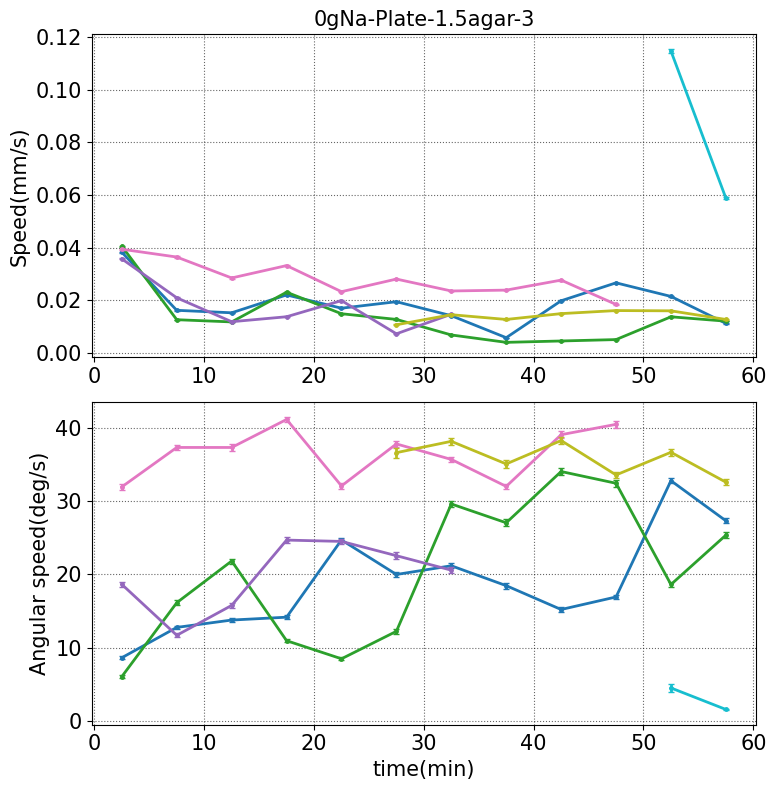

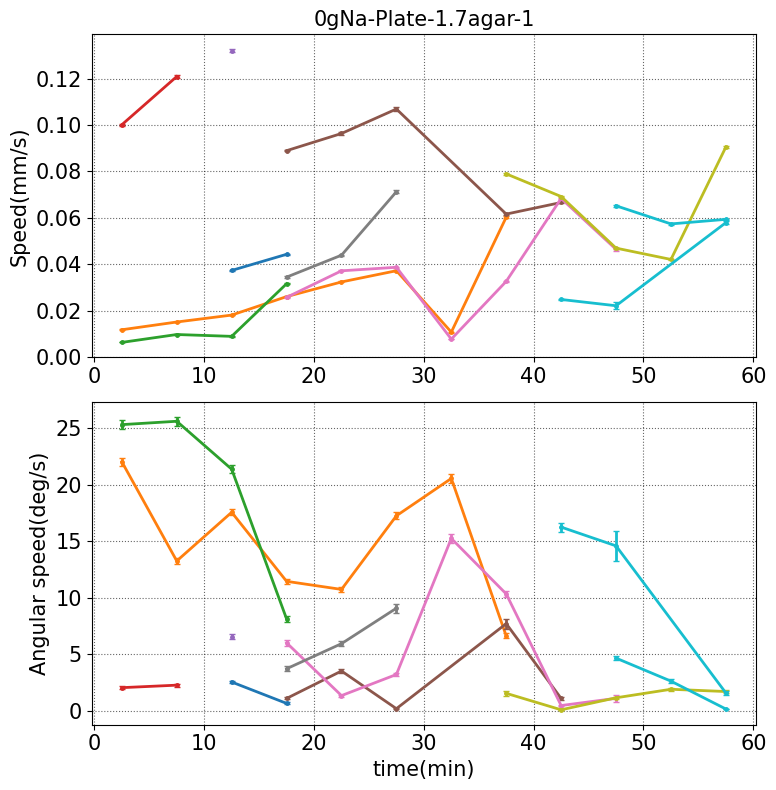

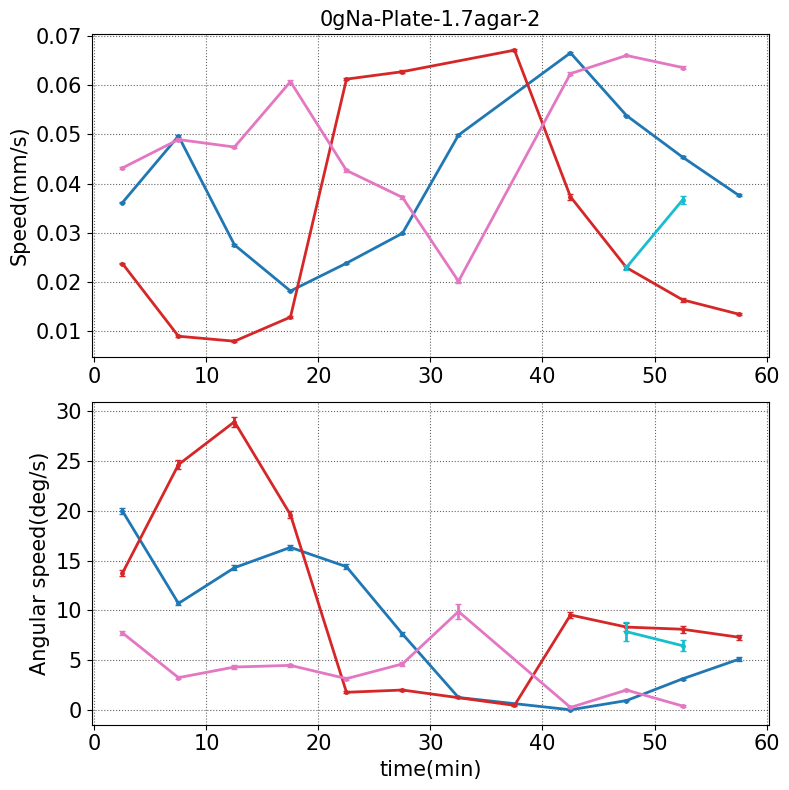

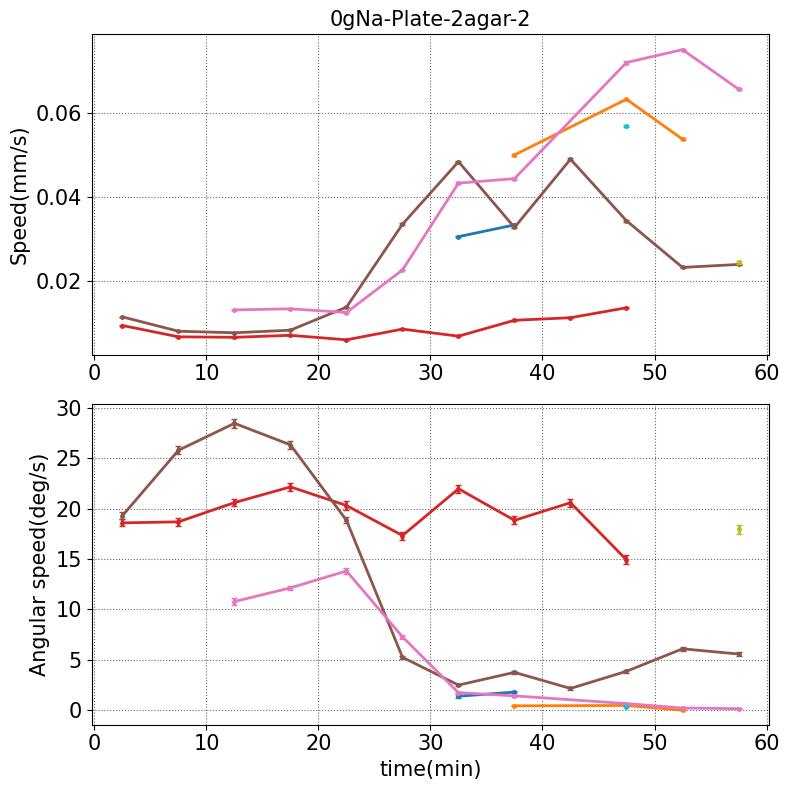

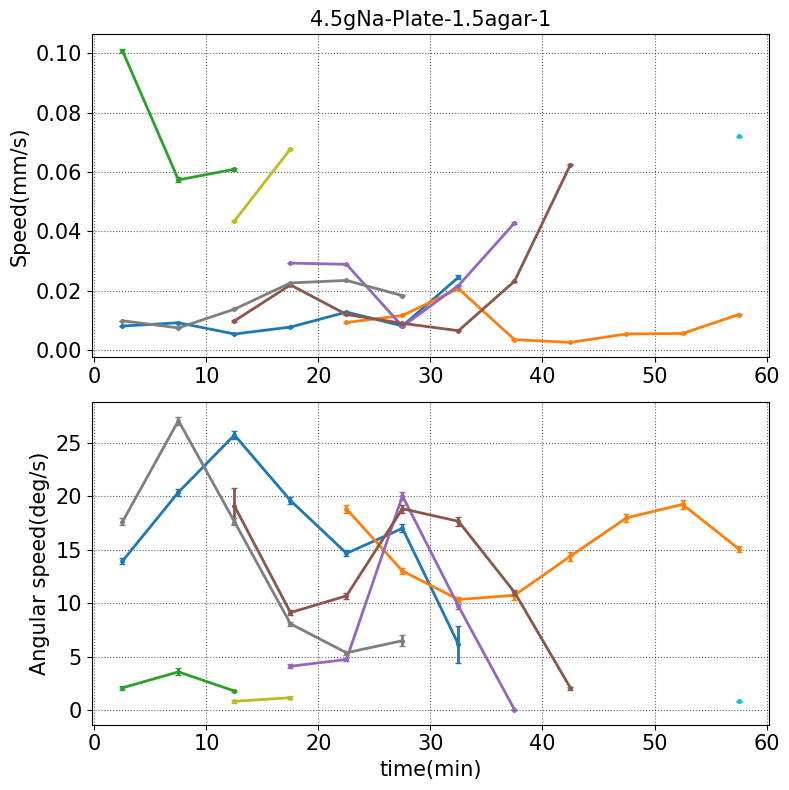

...

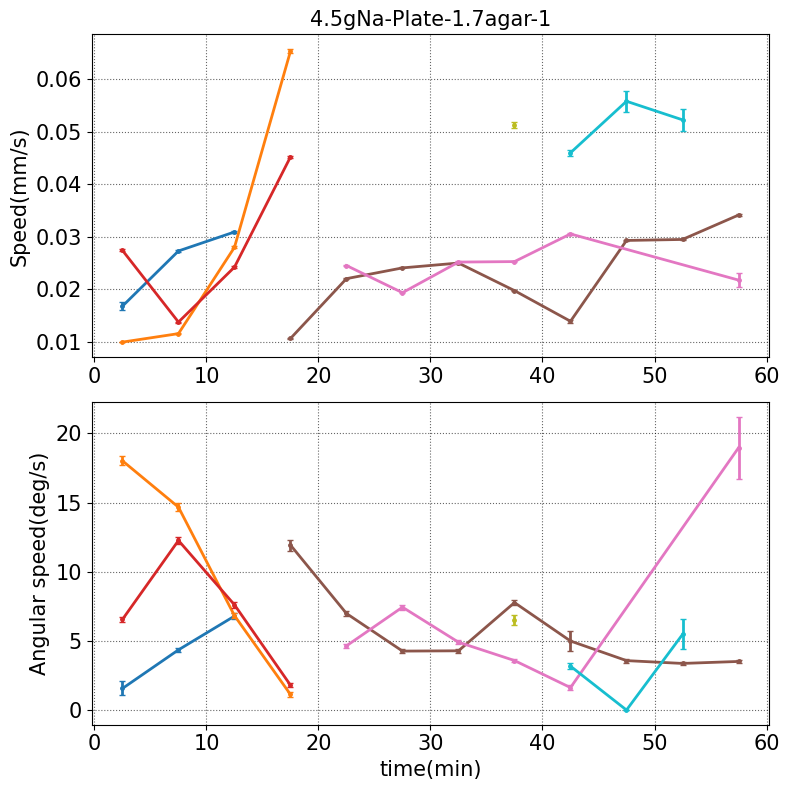

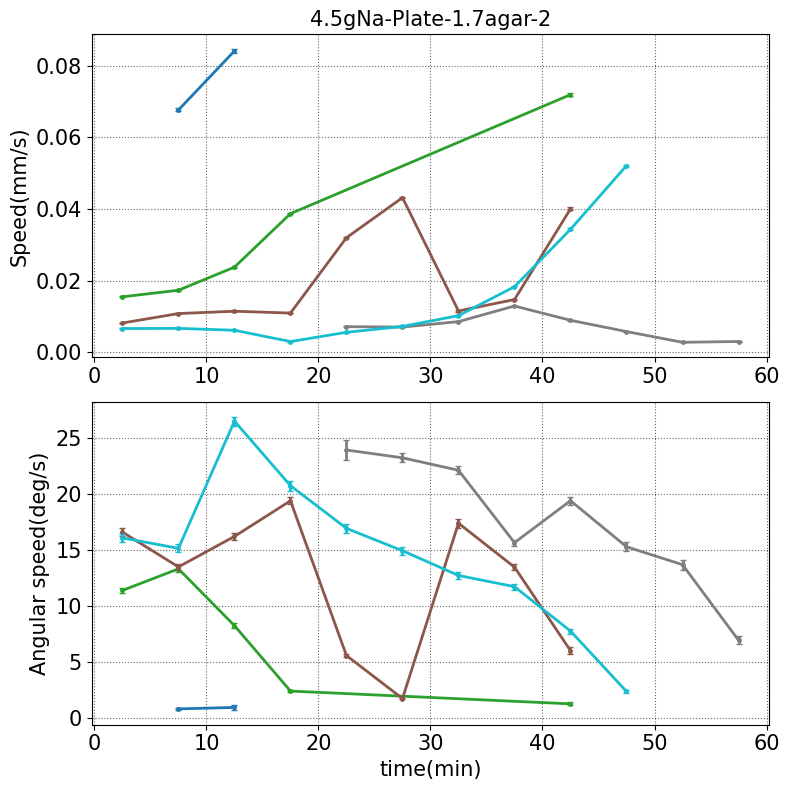

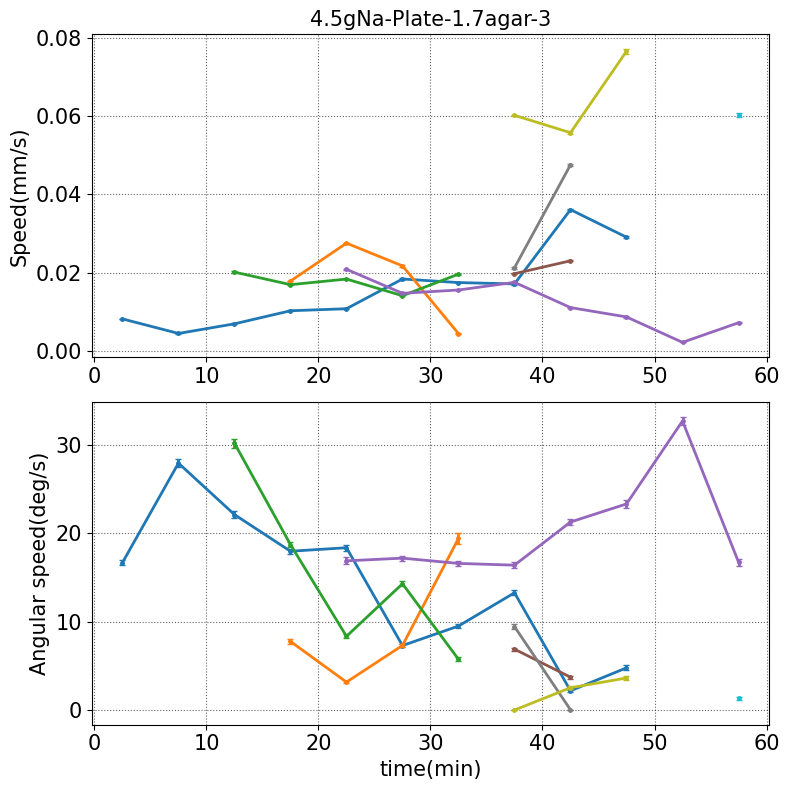

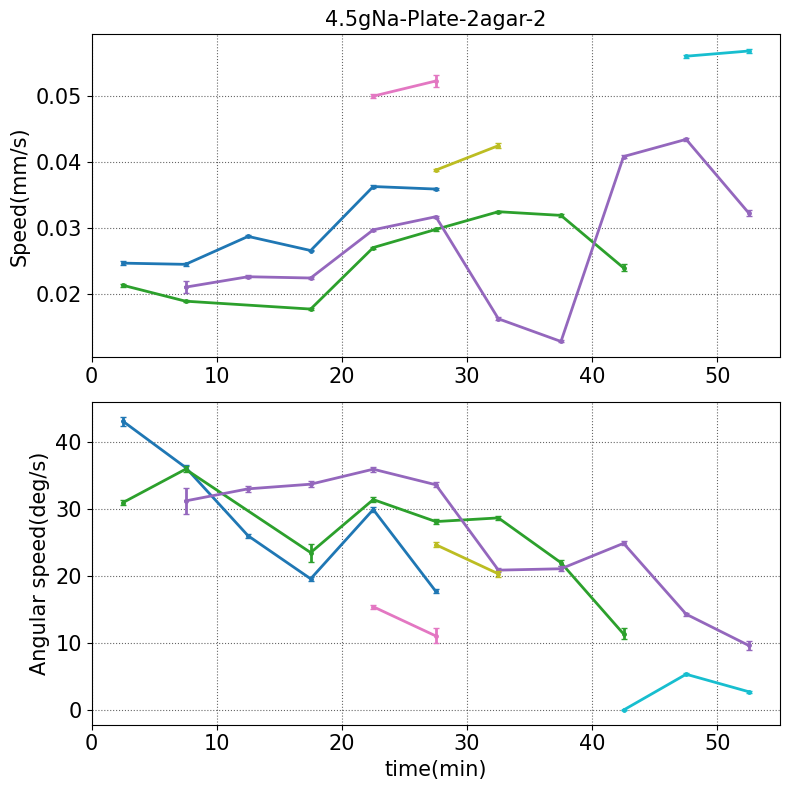

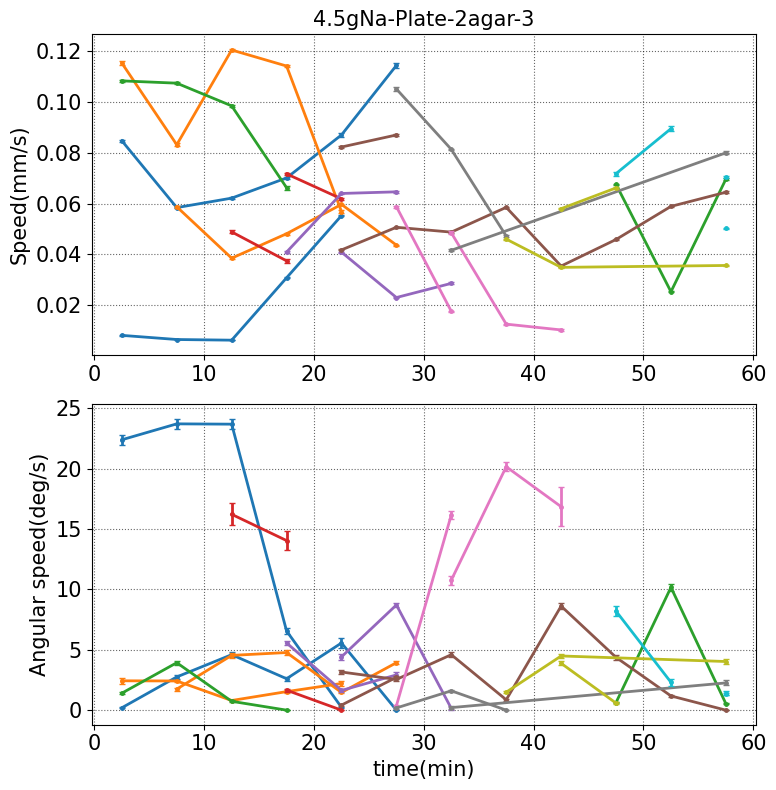

In [44]:
# 单个group一张图
# 速度角速度组内比较，同一组内比较每个id的速度角速度随时间变化
# 每一个condition_replica-id为一列，图中每一条线为一个id，分配一组颜色

# 速度角速度组内比较

conds = conds_1203
df = df_1203

ls = 15
fs = 15
lw = 2
angle = 45

# 根据关键词筛选颜色
# key_1 = '0gNa-OP50'
key_1 = ''
# color_map = ['summer', 'autumn']
colormap = 'tab10'

        
# df_g_c = df.groupby('Condition')['Group_id'].nunique().reset_index()
# group_num = df_g_c.Group_id.sum()



for j in range(len(conds)):
    df_cond = df_als_new[df_als_new['Condition']==conds[j]]
    g_c = df_cond.Group_id.unique()
    for g in range(len(g_c)):
        df_con_g = df_cond[df_cond.Group_id==g_c[g]]
        df_con_g_run= df_con_g[df_con_g['Event']==0]                # 去掉了sharp turn 的数据
        
        fig,ax = plt.subplots(2,1, figsize = (8,8))        # (7,6) or(6,8)
        ax[0].set_title(str(conds[j])+'-'+str(g_c[g]), fontsize = fs)
        
        # 根据时间段画出平均速度，平均角速率，距圆心距离，CTX的分布(柱状图)
        df_id_by_prd = df_con_g_run.groupby(['ID','Period_draw']).agg({'agl_speed':['mean','sem'],'speed':['mean','sem']}).reset_index()
        # 更简洁列名
        df_id_by_prd.columns = ['_'.join(col).strip() if isinstance(col, tuple) else col for col in df_id_by_prd.columns.values]
        df_id_by_prd = df_id_by_prd.rename(columns={'ID_':'ID', 'Period_draw_':'Period_draw'})
        id_g = df_id_by_prd.ID.unique()
        # 为每个id分配颜色
        cmap = mpl.colormaps[colormap](np.linspace(0,1,len(id_g)))
        id_colors = {idx: cmap[i] for i,idx in enumerate(id_g)}
        for idx, df_idx in df_id_by_prd.groupby('ID'):
            
            # 循环每个id作图
            ax[0].errorbar(df_idx.Period_draw, df_idx['speed_mean'], yerr = df_idx['speed_sem'],
                             fmt = 'None', ecolor = id_colors[idx], capsize = 2, linewidth = lw)
            ax[0].plot(df_idx.Period_draw, df_idx['speed_mean'], color = id_colors[idx],
                         marker = 'o',markersize = 2.5,
                         label = 'id:'+str(idx), linewidth = lw)
            ax[1].errorbar(df_idx.Period_draw, df_idx['agl_speed_mean'], yerr = df_idx['agl_speed_sem'],
                             fmt = 'None', ecolor = id_colors[idx], capsize = 2, linewidth = lw)
            ax[1].plot(df_idx.Period_draw, df_idx['agl_speed_mean'], color = id_colors[idx],
                         marker = 'o',markersize = 2.5,
                         label = 'id:'+str(idx), linewidth = lw)

        ax[0].grid(True,linestyle=':',color='black',alpha=0.6)
        ax[0].set_ylabel('Speed(mm/s)', fontsize = fs)
#         ax[0].legend(bbox_to_anchor = (1.01, 0.05),loc = 3,fontsize = fs*1.25, fancybox = True)
                # 设置图片刻度和字体大小
        ax[0].tick_params(labelsize=ls)


        ax[1].grid(True,linestyle=':',color='black',alpha=0.6)
        ax[1].set_ylabel('Angular speed(deg/s)', fontsize = fs)
        ax[1].set_xlabel('time(min)', fontsize = fs)

        ax[1].tick_params(labelsize=ls)
        
        plt.tight_layout()
        if new_folder:
        #  保存图片
            title_name = 'agl-psd'+str(conds[j])+str(g_c[g])+'.png'
            file_path = os.path.join(new_folder, title_name)
            plt.savefig(file_path,bbox_inches='tight')
        else:
            plt.show()

### 距离中线的平均位移

2
0gNa(0gNa)-1
0gNa(0gNa)-2
2
0gNa(3gNa)-1
0gNa(3gNa)-2
2
4.5gNa(0gNa)-1
4.5gNa(0gNa)-2
2
4.5gNa(3gNa)-1
4.5gNa(3gNa)-2


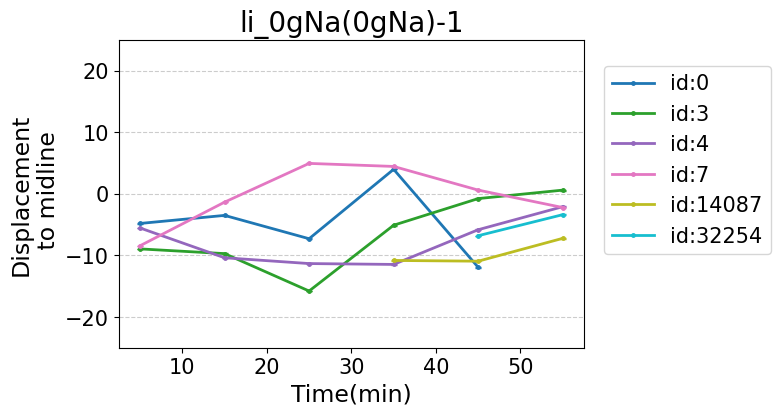

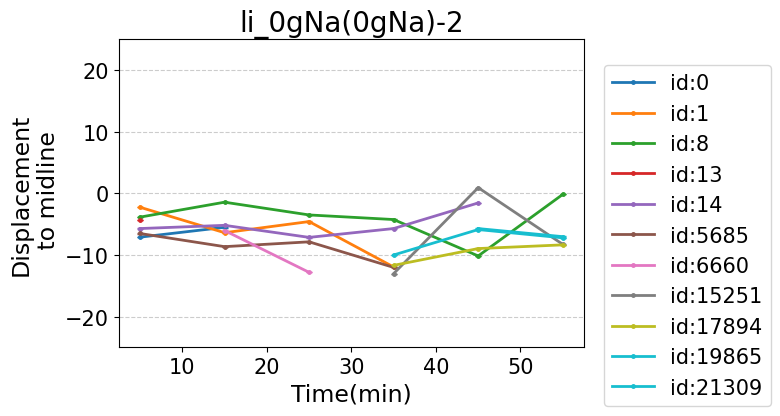

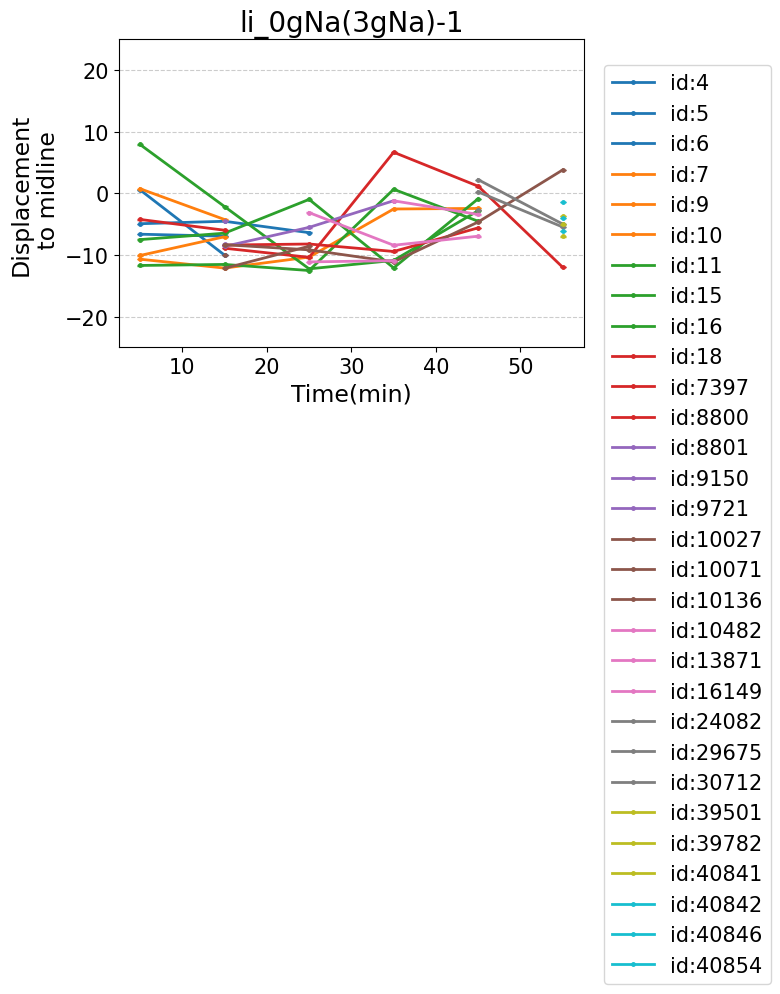

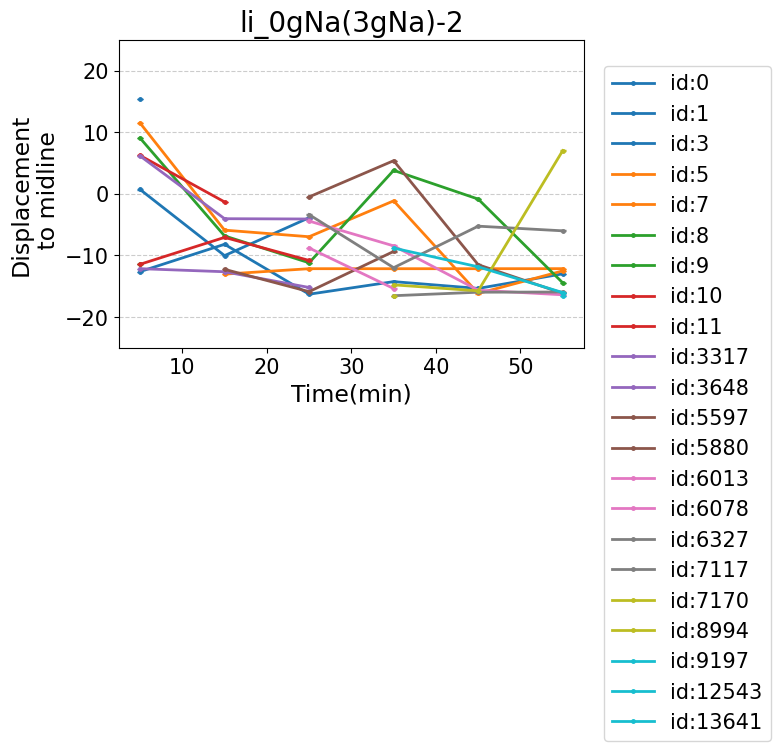

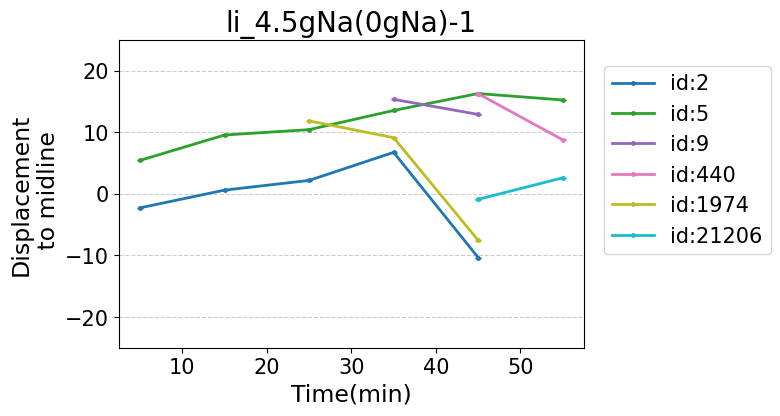

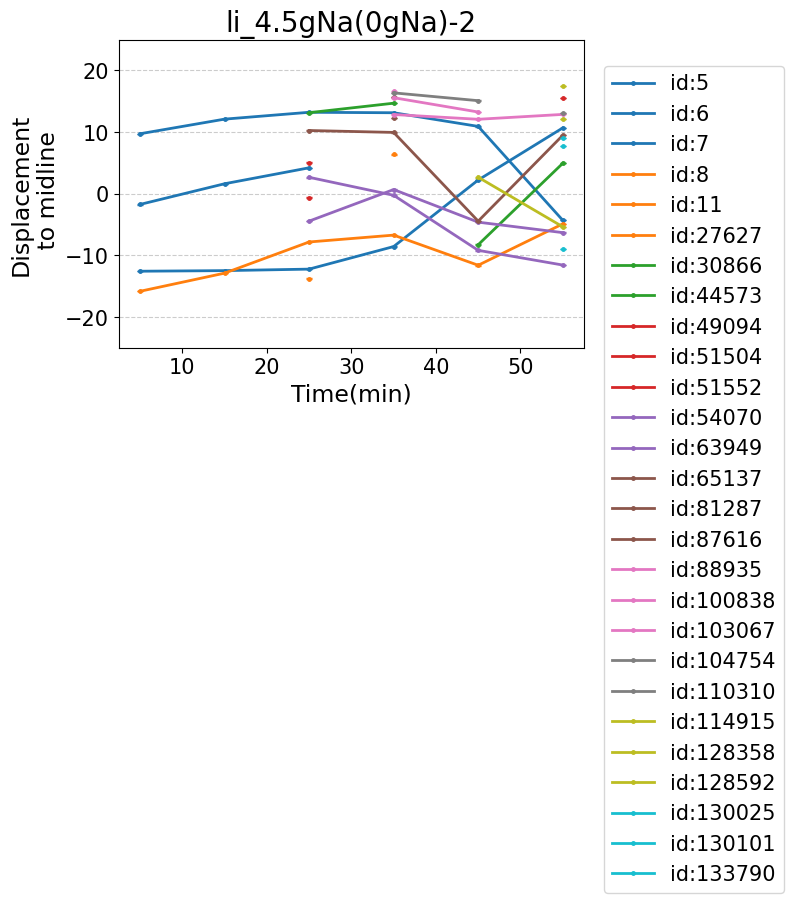

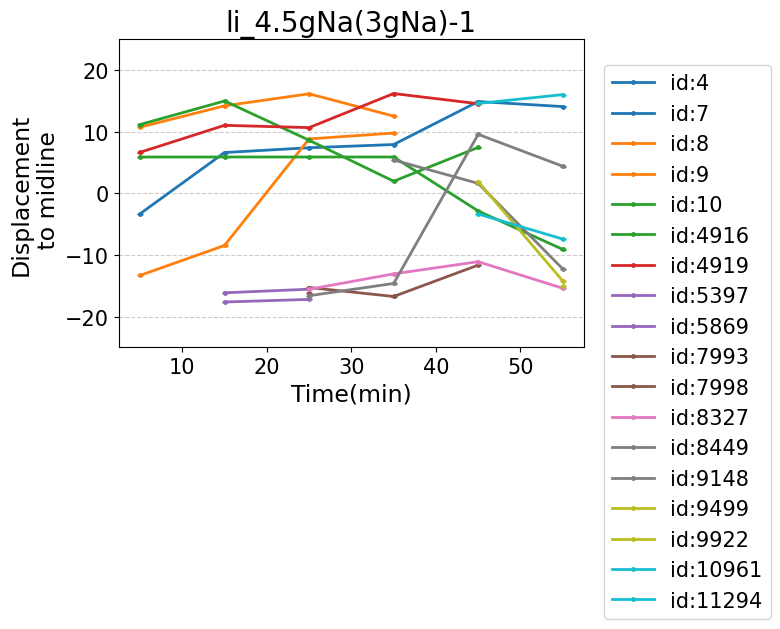

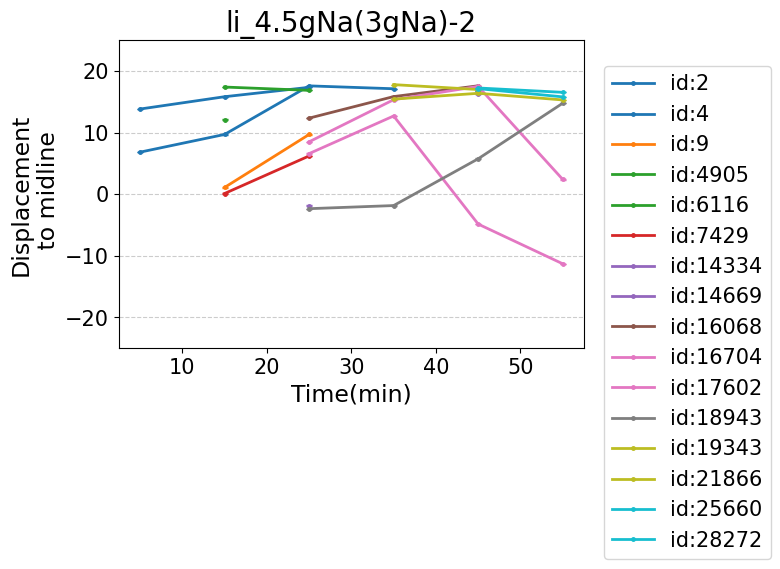

In [17]:
# 组内各个id比较
df = df_1213_li
conds = conds_1213_li
spf_title = 'li_'
color_map = 'tab10'
time_len = 1     # h
time_inv = 10       # min
ls = 15
fs = 20
lw = 2
angle = 45
frame_length = 0.025  # mm
frame_rate = 20
y_lim = [-25,25]


# 灵活设置时间间隔
num_frames = time_len*3600*frame_rate
periods = np.arange(0,time_len*60+1,time_inv)
periods_timestamp = np.arange(0, num_frames+1, time_inv*60*frame_rate)
labels = [(periods[i] + periods[i + 1]) / 2 for i in range(len(periods) - 1)]
df['Period_label'] = pd.cut(df['Timestamp'], bins=periods_timestamp, labels=labels, right=False,include_lowest=True)   # right=False表示区间左闭右开
        
for j in range(len(conds)):
    df_cond = df[df['Condition']==conds[j]]
    num_g_c = df_cond.Group_id.unique()
    print(len(num_g_c))
    for g in range(len(num_g_c)):
        print(str(conds[j])+'-'+str(num_g_c[g]))
        fig,ax = plt.subplots(1,1, figsize = (6,4))        # (7,6) or(6,8)
        
        df_con_g = df_cond[df_cond.Group_id==num_g_c[g]]
        df_con_g_run= df_con_g[df_con_g['Event']==0]                # 去掉了sharp turn 的数据
        
        # 根据时间段画出平均速度，平均角速率，距圆心距离，CTX的分布(柱状图)
        df_id_by_prd = df_con_g_run.groupby(['ID','Period_label']).agg({'Disp_to_mid':['mean','sem']}).reset_index()
        df_id_by_prd.columns = ['_'.join(col).strip() if isinstance(col, tuple) else col for col in df_id_by_prd.columns.values]
        df_id_by_prd = df_id_by_prd.rename(columns={'ID_':'ID', 'Period_label_':'Period_label'})
        df_id_by_prd.loc[:,'Disp_to_mid_mean'] = df_id_by_prd['Disp_to_mid_mean']*frame_length
        df_id_by_prd.loc[:,'Disp_to_mid_sem'] = df_id_by_prd['Disp_to_mid_sem']*frame_length
        id_g = df_id_by_prd.ID.unique()
        # 为每个id分配颜色
        cmap = mpl.colormaps[colormap](np.linspace(0,1,len(id_g)))
        id_colors = {idx: cmap[i] for i,idx in enumerate(id_g)}
        for idx, df_idx in df_id_by_prd.groupby('ID'):
        
        
            # 判断，将出现nan值的组进行裁剪
            if df_idx['Disp_to_mid_mean'].isna().all():   # 如果所有都是nan值
                first_nan_index = df_idx['Disp_to_mid'].first_valid_index() 
            elif ~df_idx['Disp_to_mid_mean'].isna().any():#如果没有nan值
                first_nan_index = df_idx.index.max()
            else:
                # 返回第一个nan值得索引
                first_nan_index = df_idx['Disp_to_mid_mean'].isna().idxmax()
            if not np.isnan(first_nan_index):
                df_idx = df_idx.iloc[:first_nan_index]

            # 距离中心的位移
            ax.errorbar(df_idx['Period_label'], df_idx['Disp_to_mid_mean'], yerr = df_idx['Disp_to_mid_sem'],fmt = 'None', ecolor = id_colors[idx], capsize = 2, linewidth = lw)
            ax.plot(df_idx['Period_label'], df_idx['Disp_to_mid_mean'], color = id_colors[idx], marker = 'o',markersize = 2.5,
                    label = 'id:'+str(idx), linewidth = lw)
        if y_lim:
            plt.ylim(y_lim[0], y_lim[1])
        plt.title(spf_title+str(conds[j])+'-'+str(num_g_c[g]), fontsize = fs)
        plt.xlabel('Time(min)', fontsize=fs*0.85)
        plt.ylabel('Displacement\n to midline', fontsize=fs*0.85)
        plt.tick_params(labelsize = fs*0.75)
        plt.grid(color = 'grey', linestyle = 'dashed', alpha=0.4, axis='y')
        plt.legend(bbox_to_anchor = (1.02,0.95), fontsize=fs*0.75)
        if new_folder:
        #  保存图片
            title_name = spf_title+'Disp-Midl'+str(conds[j])+str(num_g_c[g])+'.png'
            file_path = os.path.join(new_folder, title_name)
            plt.savefig(file_path,bbox_inches='tight')
        else:
            plt.show()


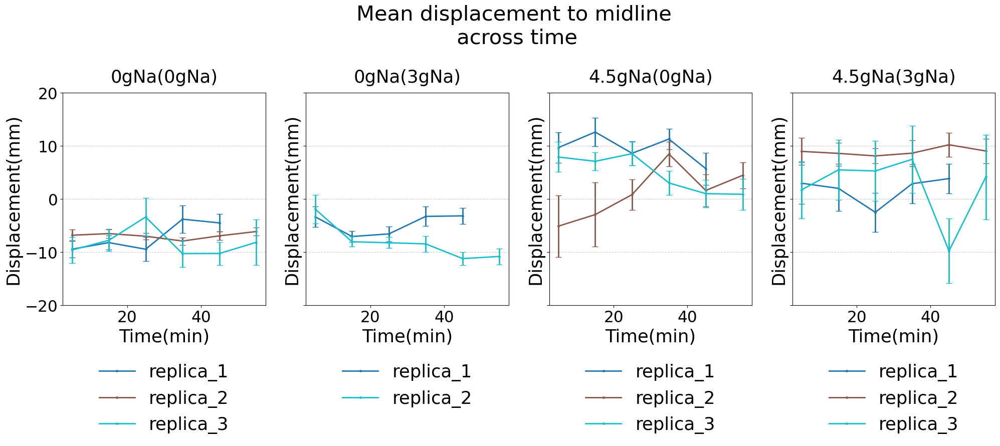

In [31]:
# 组内比较
# 一张大图，condition数量等于列数
# 每个子图标题为condition，每一条为每个group中各个id的平均距离的均值的均值随时间的变化


df = df_1213_all
conds = conds_1213_all
spf_title = ''
colormap = 'tab10'
y_lim = [-20,20]
time_len = 1     # h
time_inv = 10       # min
ls = 15
fs = 30
lw = 2
angle = 45
frame_length = 0.025  # mm
frame_rate = 20


# 灵活设置时间间隔
num_frames = time_len*3600*frame_rate
periods = np.arange(0,time_len*60+1,time_inv)
periods_timestamp = np.arange(0, num_frames+1, time_inv*60*frame_rate)
labels = [(periods[i] + periods[i + 1]) / 2 for i in range(len(periods) - 1)]
df['Period_label'] = pd.cut(df['Timestamp'], bins=periods_timestamp, labels=labels, right=False,include_lowest=True)   # right=False表示区间左闭右开

        
fig,ax = plt.subplots(1,len(conds), figsize = (6*len(conds),5.5), sharey = True)        # (7,6) or(6,8)
plt.suptitle(spf_title+'Mean displacement to midline\n across time', fontsize = fs, y =1.2)
n = 0  # 第n列
for j in range(len(conds)):
    df_cond = df[df['Condition']==conds[j]]
    
    # 第一步求每个组每个id在每个时间区间的均值
    df_id_by_prd = df_cond.groupby(['Group_id','Period_label','ID']).agg({'Disp_to_mid':'mean'}).reset_index()
    df_gp_by_prd = df_id_by_prd.groupby(['Group_id','Period_label']).agg({'Disp_to_mid':['mean','sem']}).reset_index()
    df_gp_by_prd.columns = ['_'.join(col).strip() if isinstance(col, tuple) else col for col in df_gp_by_prd.columns.values]
    df_gp_by_prd = df_gp_by_prd.rename(columns={'Group_id_':'Group_id', 'Period_label_':'Period_label'})
    df_gp_by_prd.loc[:,'Disp_to_mid_mean'] = df_gp_by_prd['Disp_to_mid_mean']*frame_length
    df_gp_by_prd.loc[:,'Disp_to_mid_sem'] = df_gp_by_prd['Disp_to_mid_sem']*frame_length
    
    groups = df_gp_by_prd.Group_id.unique()
    # 为每个id分配颜色
    cmap = mpl.colormaps[colormap](np.linspace(0,1,len(groups)))
    id_colors = {idx: cmap[i] for i,idx in enumerate(groups)}
    for g, df_g in df_gp_by_prd.groupby('Group_id'):
        # 判断，将出现nan值的组进行裁剪
        if df_g['Disp_to_mid_mean'].isna().all():   # 如果所有都是nan值
            first_nan_index = df_g['Disp_to_mid'].first_valid_index() 
        elif ~df_g['Disp_to_mid_mean'].isna().any():#如果没有nan值
            first_nan_index = df_g.index.max()
        else:
            # 返回第一个nan值得索引
            first_nan_index = df_g['Disp_to_mid_mean'].isna().idxmax()
        if not np.isnan(first_nan_index):
            df_g = df_g.iloc[:first_nan_index]

        # 距离中心的位移
        ax[n].errorbar(df_g['Period_label'], df_g['Disp_to_mid_mean'], yerr = df_g['Disp_to_mid_sem'],fmt = 'None',
                       ecolor = id_colors[g],
                       capsize = lw*2,
                       linewidth = lw)
        ax[n].plot(df_g['Period_label'], df_g['Disp_to_mid_mean'],
                   color = id_colors[g],
                   marker = 'o',
                   markersize = 2.5,
                label = 'replica_'+str(g),
                   linewidth = lw)
        ax[n].set_title(str(conds[j]), fontsize=fs*0.85, pad = fs*0.5)
        ax[n].set_xlabel('Time(min)', fontsize=fs*0.85)
        ax[n].set_ylabel('Displacement(mm)', fontsize=fs*0.85)
        ax[n].grid(color = 'grey', linestyle = 'dashed', alpha=0.4, axis='y')
        ax[n].legend(loc='upper center', bbox_to_anchor=(0.5, -0.2),fontsize=fs*0.85, ncol=1, frameon=False)
        ax[n].tick_params(labelsize = fs*0.75)
    n += 1
plt.subplots_adjust(hspace=0.2, wspace=0.2)
if y_lim:
    plt.ylim(y_lim[0],y_lim[1])
if new_folder:
#  保存图片
    title_name = spf_title+'Disp-Midl_btw_conds_groups'+'.png'
    file_path = os.path.join(new_folder, title_name)
    plt.savefig(file_path,bbox_inches='tight')
else:
    plt.show()


# 轨迹分布

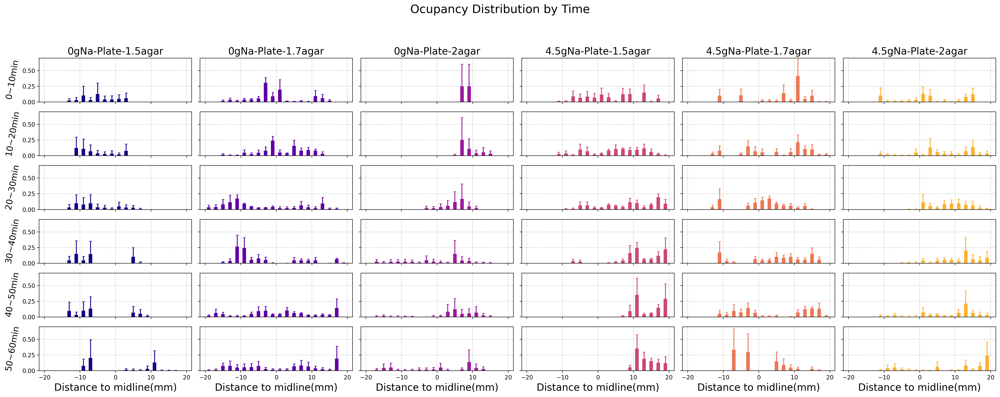

In [64]:
# # 组件分布
# df = df_1203
# conds = conds_1203
# dist_range = [-20,20]    # 数据中的坐标范围，单位mm
# dist_inv = 2           # 设定距离区间分组间隔， 单位mm
# pixel_length = 0.025     # mm
# interval = 10    # min 计算分布的数据的时间窗间隔
# slide_win = 10   # min 滑动时间窗长度：两个计算时间窗之间的时间间隔
# unpper_bound = 60 # min 包含轨迹的时间区间最高不超过upper_bound
# t_inv_vec = []   # 如果有需要，提前指定时间序列，不需要前两个时间窗参数
# time_len = 1
# width = 1
# fs = 20
# color_map = 'plasma'
# color_dict = {}
# key_word = ''    # key_word会被加在总标题首部
# sharey = True
# # y_lim = [0,0.6]
# y_lim = [0,0.7]
# new_folder = new_folder

# if len(t_inv_vec):
#     # 如果定义了时间区间，直接使用
#     pass
# else:
#     # 如果没有定义，根据interval生成所有区间并循环作图
#     t_inv_vec = []
#     i = 0
#     t_inv = [i*interval, interval*(i+1)]    # 第一个计算时间区间
#     t_inv_vec.append(t_inv)
#     while t_inv[1]<unpper_bound:
#         i += 1
#         t_inv = (i*slide_win, i*slide_win+interval)
#         t_inv_vec.append(t_inv)
# num_inv = len(t_inv_vec)
    
# # conds生成color_dict.可直接输入color_dict
# if color_dict:
#     pass
# else:
#     color_vec_norm = np.linspace(0.01,0.99,len(conds)+1)
#     colormap = mpl.colormaps[color_map]
#     colors  = colormap(color_vec_norm)
#     color_dict = {}
#     for i, d in enumerate(conds):
#         color_dict[d] = colors[i]

# # 根据conds排序
# df['Condition'] = pd.Categorical(df['Condition'], categories=conds, ordered=True)
# df.sort_values(by = 'Condition')


# # 灵活根据距中线的距离分配距离区间
# num_pixels = np.array(dist_range)/pixel_length
# dist_vecs = np.arange(dist_range[0],dist_range[1]+1,dist_inv)
# dist_pixel_vecs = np.arange(num_pixels[0], num_pixels[1]+1, dist_inv/pixel_length)
# labels = [(dist_vecs[i] + dist_vecs[i + 1]) / 2 for i in range(len(dist_vecs) - 1)]
# df['Dist_label'] = pd.cut(df['Disp_to_mid'], bins=dist_pixel_vecs, labels=labels, right=False,include_lowest=True)   # right=False表示区间左闭右开
# df_sorted = df.dropna(subset = 'Dist_label')
# df_sorted_series = sorted(df_sorted.Dist_label.unique())   # 去掉Dist_inx_draw为nan值的行
# df_dist_idx = pd.DataFrame({'Dist_label':df_sorted_series})  # 提取距离标签序列
# # 时间区间为行，date_condition为列，合并输出一张大图
# fig,ax = plt.subplots(num_inv, len(conds),dpi=200, figsize = (4*len(conds),1.5*num_inv), tight_layout = True, sharex = True, sharey = sharey)
# plt.suptitle(key_word+'Ocupancy Distribution by Time',y=1.05, fontsize=fs)
# plt.subplots_adjust(top=0.90)

# c = 0      # 循环打印不同date_condition组合数据
# for con, df_c in df.groupby('Condition'):
#     # 求每一d_c组数据本身的时间区间
#     frame_per_min = int(max(df_c['Timestamp'])/(time_len*60))
#     j = 0    # 循环打印不同时间区间的数据
#     for t_inv in t_inv_vec:
#         # 根据时间分出一段df
#         start_timestamp = t_inv[0]*frame_per_min
#         end_timestamp = t_inv[1]*frame_per_min
#         df_d_c_t = df_c[(df_c.Timestamp >= start_timestamp) & (df_c.Timestamp < end_timestamp)]

#         count_in_dist_each_group = df_d_c_t.groupby(['Dist_label','Group_id'])['Timestamp'].count().reset_index()
#         sum_each_group = df_d_c_t.groupby('Group_id')['Timestamp'].count().reset_index()
#         df_ratio_in_dist_inv = pd.merge(count_in_dist_each_group, sum_each_group, on = 'Group_id', how = 'outer')
#         df_ratio_in_dist_inv.rename(columns={'Timestamp_x':'Count_dist','Timestamp_y':'Count_sum'}, inplace = True)
#         df_ratio_in_dist_inv.loc[:,'Count_ratio'] = df_ratio_in_dist_inv['Count_dist']/df_ratio_in_dist_inv['Count_sum']
#     #     df_test = df_ratio_in_dist_inv.groupby('Group_id')['Count_ratio'].sum()
#         # 求每一个group中每个dist区间(包含轨迹的)的占比
#         group_num = len(df_d_c_t.Group_id.unique())    # 给定时间段和实验条件组中重复组的数量
#         df_group_series = pd.Series([i+1 for i in range(group_num)], name='Group_id')
#         df_dist_g = pd.merge(df_dist_idx, df_group_series.to_frame(), how = 'cross')   # 生成标准距离区间和重复组df
#         df_ratio = pd.merge(df_ratio_in_dist_inv, df_dist_g, on=['Dist_label','Group_id'], how = 'outer')   # 合并轨迹数据点占比df
# #             df_ratio = pd.merge(df_dist_idx, df_ratio_in_dist_inv, on = 'Dist_idx_draw', how = 'outer')
#         df_ratio['Count_dist'] = df_ratio['Count_ratio'].fillna(0)
#         df_ratio['Count_sum'] = df_ratio['Count_sum'].fillna(0)
#         df_ratio['Count_ratio'] = df_ratio['Count_ratio'].fillna(0)
#         df_ratio_mean_std = df_ratio.groupby('Dist_label')['Count_ratio'].agg(['mean','std']).reset_index()
#         df_ratio_mean_std.loc[:,'se'] = df_ratio_mean_std['std']/np.sqrt(group_num)
#         df_ratio_mean_std = df_ratio_mean_std.fillna(0)
#         ax[j,c].grid(linestyle = 'dashed', color = 'grey', alpha = 0.4, which = 'major')
#         ax[j,c].bar(df_ratio_mean_std.Dist_label, df_ratio_mean_std['mean'],width=width,yerr = df_ratio_mean_std['se'],ecolor = color_dict[con], capsize = 2, alpha =1, color = color_dict[con]) 
# #             ax[j].set_ylabel('fraction', fontsize = fs*0.85)
#         if y_lim:
#             ax[j,c].set_ylim(y_lim[0],y_lim[1])
#         if j==0:
#             ax[j,c].set_title(con,fontsize = fs*0.85)
#         if c==0:
#             ax[j,c].set_ylabel(f'{t_inv[0]}~{t_inv[1]}min',fontsize = fs*0.75,rotation=80,labelpad=fs*0.5)
#         if j==num_inv-1:    # 最后一行
#             ax[j,c].set_xlabel('Distance to midline(mm)',fontsize = fs*0.85)
#         j += 1
#     c += 1
# plt.subplots_adjust(hspace=1, wspace=0.2)
# if new_folder:
#     title_name = key_word+'Bar_dist_by_time.png'
#     file_path = os.path.join(new_folder, title_name)
#     plt.savefig(file_path,bbox_inches='tight')
# else:
#     plt.show()

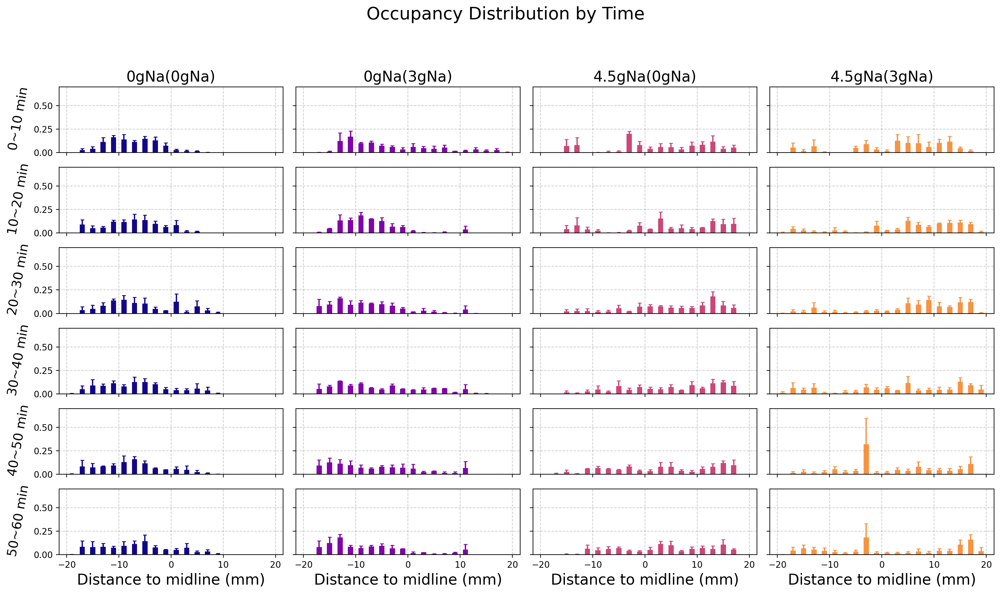

In [32]:
# 组间比较，简化后代码

df = df_1213_all
conds = conds_1213_all

# 配置参数
dist_range = [-20, 20]  # 数据坐标范围 (mm)
dist_inv = 2            # 距离区间间隔 (mm)
pixel_length = 0.025    # 每像素长度 (mm)
interval = 10           # 时间窗间隔 (min)
slide_win = 10          # 滑动时间窗间隔 (min)
upper_bound = 60        # 最大时间窗口上限 (min)
color_map = 'plasma'
sharey = True
y_lim = [0, 0.7]
fs = 20
width = 1
key_word = ''
new_folder = None  # 保存路径，若为 None 则展示图形
t_inv_vec = []

# 生成时间区间
if t_inv_vec:
    pass
else:
    t_inv_vec = [[i * slide_win, i * slide_win + interval] for i in range((upper_bound - interval) // slide_win + 1)]

# 生成颜色字典
color_dict = color_dict or {
    d: mpl.colormaps[color_map](norm) 
    for d, norm in zip(conds, np.linspace(0.01, 0.99, len(conds)))
}

# 数据预处理
df['Condition'] = pd.Categorical(df['Condition'], categories=conds, ordered=True)
df.sort_values(by='Condition', inplace=True)

num_pixels = np.array(dist_range) / pixel_length
dist_vecs = np.arange(dist_range[0], dist_range[1] + 1, dist_inv)
dist_pixel_vecs = np.arange(num_pixels[0], num_pixels[1] + 1, dist_inv / pixel_length)
labels = [(dist_vecs[i] + dist_vecs[i + 1]) / 2 for i in range(len(dist_vecs) - 1)]
df['Dist_label'] = pd.cut(df['Disp_to_mid'], bins=dist_pixel_vecs, labels=labels, right=False, include_lowest=True)
df_sorted = df.dropna(subset=['Dist_label'])
df_dist_idx = pd.DataFrame({'Dist_label': sorted(df_sorted['Dist_label'].unique())})

# 绘图
fig, ax = plt.subplots(len(t_inv_vec), len(conds), dpi=200, figsize=(4 * len(conds), 1.5 * len(t_inv_vec)), 
                       tight_layout=True, sharex=True, sharey=sharey)
plt.suptitle(f"{key_word} Occupancy Distribution by Time", y=1.05, fontsize=fs)
plt.subplots_adjust(top=0.9, hspace=1, wspace=0.2)

for c, (con, df_c) in enumerate(df.groupby('Condition')):
    frame_per_min = int(max(df_c['Timestamp']) / 60)  # 每分钟的帧数
    for j, (start, end) in enumerate(t_inv_vec):
        start_timestamp, end_timestamp = start * frame_per_min, end * frame_per_min
        df_window = df_c[(df_c['Timestamp'] >= start_timestamp) & (df_c['Timestamp'] < end_timestamp)]
        
        # 计算比例
        counts = df_window.groupby(['Dist_label', 'Group_id'])['Timestamp'].count().reset_index()
        totals = df_window.groupby('Group_id')['Timestamp'].count().reset_index()
        df_ratio = pd.merge(counts, totals, on='Group_id', how='outer', suffixes=('_dist', '_total'))
        df_ratio['Count_ratio'] = df_ratio['Timestamp_dist'] / df_ratio['Timestamp_total']
        
        group_num = len(df_window['Group_id'].unique())
        df_dist_g = pd.merge(df_dist_idx, pd.Series(range(1, group_num + 1), name='Group_id'), how='cross')
        df_ratio = pd.merge(df_dist_g, df_ratio, on=['Dist_label', 'Group_id'], how='outer').fillna(0)
        df_stats = df_ratio.groupby('Dist_label')['Count_ratio'].agg(['mean', 'std']).reset_index()
        df_stats['se'] = df_stats['std'] / np.sqrt(group_num)
        
        # 绘制柱状图
        ax[j, c].grid(linestyle='dashed', color='grey', alpha=0.4)
        ax[j, c].bar(df_stats['Dist_label'], df_stats['mean'], width=width, yerr=df_stats['se'],
                     ecolor=color_dict[con], capsize=2, color=color_dict[con])
        ax[j, c].set_ylim(y_lim)
        if j == 0: ax[j, c].set_title(con, fontsize=fs * 0.85)
        if c == 0: ax[j, c].set_ylabel(f"{start}~{end} min", fontsize=fs * 0.75, rotation=80, labelpad=fs * 0.5)
        if j == len(t_inv_vec) - 1: ax[j, c].set_xlabel('Distance to midline (mm)', fontsize=fs * 0.85)

# 保存或展示图形
if new_folder:
    plt.savefig(os.path.join(new_folder, f"{key_word} Bar_dist_by_time.png"), bbox_inches='tight')
else:
    plt.show()

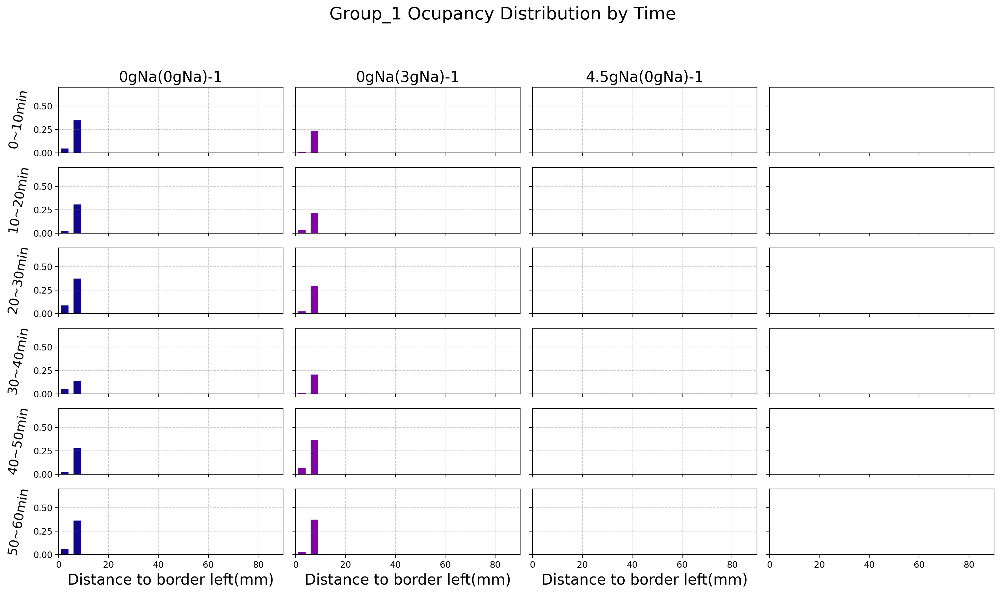

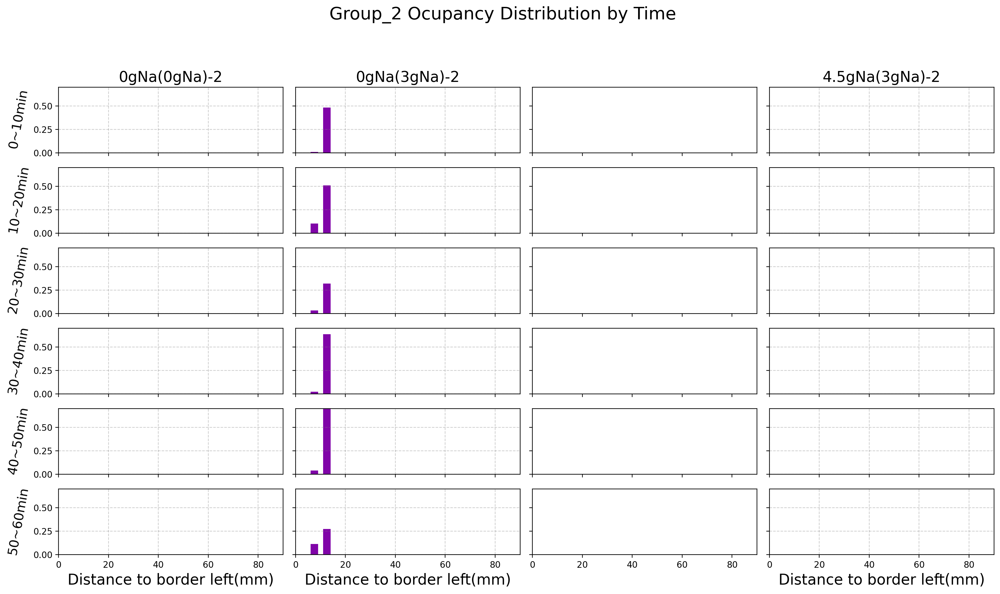

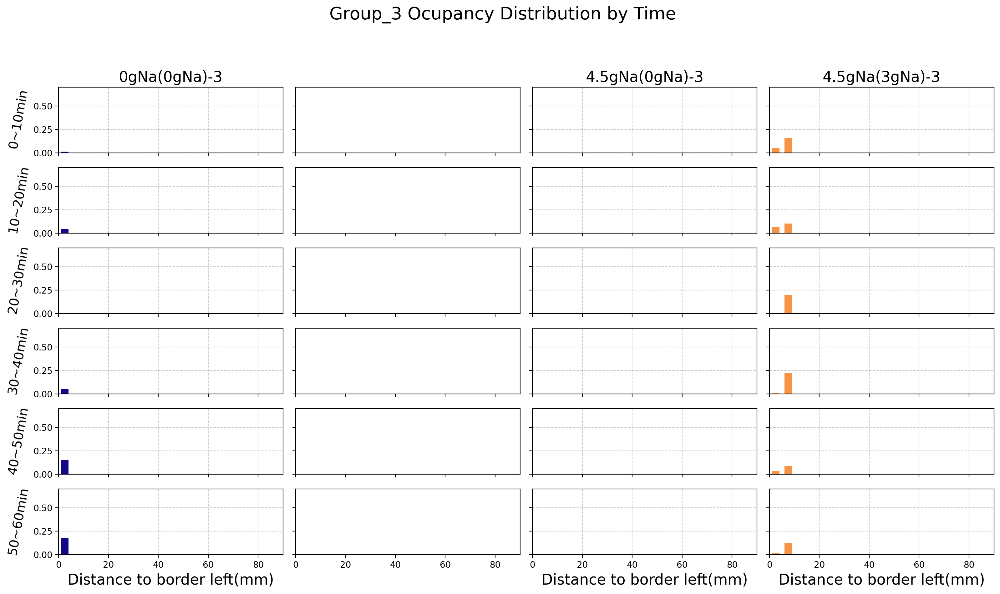

In [25]:
# 组内比较，每个group_id出一组图
df = df_1213
conds = conds_1213
interval = 10    # min 计算分布的数据的时间窗间隔
slide_win = 10   # min 滑动时间窗长度：两个计算时间窗之间的时间间隔
unpper_bound = 60 # min 包含轨迹的时间区间最高不超过upper_bound
t_inv_vec = []   # 如果有需要，提前指定时间序列，不需要前两个时间窗参数
time_len =1
width = 3
fs = 20
color_map = 'plasma'
color_dict = {}
key_word = 'he '    # key_word会被加在总标题首部
sharey = True
# y_lim = [0,0.6]
y_lim = [0,0.7]
x_lim = [0,90]
new_folder = new_folder

# 计算最大的重复组数量
num_g = df.Group_id.max()

if len(t_inv_vec):
    # 如果定义了时间区间，直接使用
    pass
else:
    # 如果没有定义，根据interval生成所有区间并循环作图
    t_inv_vec = []
    i = 0
    t_inv = [i*interval, interval*(i+1)]    # 第一个计算时间区间
    t_inv_vec.append(t_inv)
    while t_inv[1]<unpper_bound:
        i += 1
        t_inv = (i*slide_win, i*slide_win+interval)
        t_inv_vec.append(t_inv)
num_inv = len(t_inv_vec)
    
# conds生成color_dict.可直接输入color_dict
if color_dict:
    pass
else:
    color_vec_norm = np.linspace(0.01,0.99,len(conds)+1)
    colormap = mpl.colormaps[color_map]
    colors  = colormap(color_vec_norm)
    color_dict = {}
    for i, d in enumerate(conds):
        color_dict[d] = colors[i]

# 根据conds排序
df['Condition'] = pd.Categorical(df['Condition'], categories=conds, ordered=True)
df.sort_values(by = 'Condition')
df_sorted = df.dropna(subset = 'Dist_idx_draw')
df_sorted_series = sorted(df_sorted.Dist_idx_draw.unique())   # 去掉Dist_inx_draw为nan值的行
df_dist_idx = pd.DataFrame({'Dist_idx_draw':df_sorted_series})  # 提取距离标签序列，生成标准距离序列

# 每个group_id出一张图，比较不同实验条件
for i in range(1,num_g+1):
    df_g = df[df['Group_id']==i]
    key_word = f'Group_{i} '
    # 时间区间为行，date_condition为列，合并输出一张大图
    fig,ax = plt.subplots(num_inv, len(conds),dpi=200, figsize = (4*len(conds),1.5*num_inv), tight_layout = True, sharex = True, sharey = sharey)
    plt.suptitle(key_word+'Ocupancy Distribution by Time',y=1.05, fontsize=fs)
    plt.subplots_adjust(top=0.90)

    c = 0      # 循环打印不同date_condition组合数据
    for con, df_c in df_g.groupby('Condition'):
        if len(df_c):
            # 求每一d_c组数据本身的时间区间
            frame_per_min = int(max(df_c['Timestamp'])/(time_len*60))
            j = 0    # 循环打印不同时间区间的数据
            for t_inv in t_inv_vec:
                # 根据时间分出一段df
                start_timestamp = t_inv[0]*frame_per_min
                end_timestamp = t_inv[1]*frame_per_min
                df_d_c_t = df_c[(df_c.Timestamp >= start_timestamp) & (df_c.Timestamp < end_timestamp)]

                df_ratio = df_d_c_t.groupby(['Dist_idx_draw'])['Timestamp'].count().reset_index()
                df_ratio.loc[:,'ratio'] = df_ratio['Timestamp']/len(df_d_c_t)
                df_ratio_dist_idx = pd.merge(df_ratio, df_dist_idx, on = 'Dist_idx_draw', how='outer')
                df_ratio_dist_idx['ratio'].fillna(0)
                ax[j,c].grid(linestyle = 'dashed', color = 'grey', alpha = 0.4, which = 'major')
                ax[j,c].bar(df_ratio_dist_idx.Dist_idx_draw, df_ratio_dist_idx['ratio'],width=width,ecolor = color_dict[con], capsize = 2, alpha =1, color = color_dict[con]) 
        #             ax[j].set_ylabel('fraction', fontsize = fs*0.85)
                if y_lim:
                    ax[j,c].set_ylim(y_lim[0],y_lim[1])
                if j==0:
                    ax[j,c].set_title(con+'-'+str(i),fontsize = fs*0.85)
                if c==0:
                    ax[j,c].set_ylabel(f'{t_inv[0]}~{t_inv[1]}min',fontsize = fs*0.75,rotation=80,labelpad=fs*0.5)
                if j==num_inv-1:    # 最后一行
                    ax[j,c].set_xlabel('Distance to border left(mm)',fontsize = fs*0.85)

                if x_lim:
                    ax[j,c].set_xlim(x_lim[0],x_lim[1])
                j += 1
        else:
            c += 1
            continue
        c += 1
        
    plt.subplots_adjust(hspace=1, wspace=0.2)
    if new_folder:
        title_name = key_word+'Bar_dist_by_time.png'
        file_path = os.path.join(new_folder, title_name)
        plt.savefig(file_path,bbox_inches='tight')
    else:
        plt.show()

## CTX相关分析

### CTX随距离的分布
 CTX的组间比较，柱状图

In [19]:
# 分时间段作图，每个子图为单个condition，CTX_left作为柱状图高度，每个condition一个颜色
# 给时间总时长和想要的间隔时间，输出各个时间间隔的图
def CTX_left_bar_dist_btw_conds(df_als, conds, interval, time_len = 3, color_map = 'plasma', y_lim = [],spf_title = '', sharey = False,drop_tune = True, width = 3, x_ticker_spacing = 20, y_ticker_spacing = 0.25, new_folder = 0):
    # input:interval, df_als_new, time_len, color_vec, 
    # interval以分钟为单位
    # 要求输入的每组数据拍摄时长一致
    # 默认color_map是'plasma'
    
    # 删除高角速度点
    if drop_tune:
        df_als_new = df_als[df_als.Event == 0]
    else:
        df_als_new = df_als
        
    # 生成时间区间序列
    num_inv = int(time_len*60//interval)
    t_inv_vec = [(interval*i, interval*(i+1)) for i in range(num_inv)]
    
    # 根据时间段循环作图
    for t_inv in t_inv_vec:
        # 筛选时间
        frame_per_min = int(max(df_als_new['Timestamp'])/(time_len*60))
        start_timestamp = t_inv[0]*frame_per_min
        end_timestamp = t_inv[1]*frame_per_min
        print(f'start to end:{start_timestamp}and{end_timestamp}')
        df_time_j = df_als_new[(df_als_new.Timestamp >= start_timestamp) & (df_als_new.Timestamp < end_timestamp)]
        
        # 根据conds进行排序，美化图片
        df_time_j['Condition'] = pd.Categorical(df_time_j['Condition'], categories=conds, ordered=True)
        df_time_j_sorted_nan = df_time_j.sort_values(by = 'Condition')
        df_time_j_sorted = df_time_j_sorted_nan.dropna(subset='Dist_idx_draw')
        print(df_time_j_sorted.Condition.unique())
        dist_idx_draw_series = sorted(df_time_j_sorted.Dist_idx_draw.unique())
        df_dist_idx = pd.DataFrame({'Dist_idx_draw':dist_idx_draw_series})
        # color
        
        conds_vec = [i for i in range(len(conds))]
        conds_vec_norm = conds_vec/np.max(conds_vec)
        colormap = mpl.colormaps[color_map]
        colors = colormap(conds_vec_norm)
        color_dict = {conds[i]:colors[i] for i in range(len(conds))}

        # 根据condtion分类作图
        # *代码思路：根据condition分组之后作图
        fig, axes = plt.subplots(len(conds),1, figsize=(6,9), sharey = sharey, sharex = True)
        ax = axes.ravel()

        j = 0
        for condition, group in df_time_j_sorted.groupby('Condition'):
            mean_CTX_in_dist_inv = group.groupby(['Dist_idx_draw', 'Group_id'])['CTX_left'].mean().reset_index()
            group_num = len(group.Group_id.unique())
            df_CTX = pd.merge(df_dist_idx, mean_CTX_in_dist_inv, on = 'Dist_idx_draw', how = 'outer')
            std_CTX_in_dist_inv = mean_CTX_in_dist_inv.groupby('Dist_idx_draw')['CTX_left'].std().reset_index()
            std_CTX_in_dist_inv.rename(columns={'CTX_left': 'CTX_std'}, inplace = True)
            df_CTX_std = pd.merge(df_CTX, std_CTX_in_dist_inv,on='Dist_idx_draw', how = 'outer')
            df_CTX_in_dist_inv = df_CTX_std.groupby('Dist_idx_draw')[['CTX_left', 'CTX_std']].mean().reset_index()
            df_CTX_in_dist_inv.loc[:, 'CTX_sem'] = df_CTX_in_dist_inv['CTX_std']/np.sqrt(group_num)
            CTX_left_vec = np.nan_to_num(df_CTX_in_dist_inv['CTX_left'].values, nan=0)
            ax[j].grid(linestyle = 'dashed', color = 'grey', alpha = 0.4, which = 'major')
            ax[j].bar(df_CTX_in_dist_inv.Dist_idx_draw, CTX_left_vec,width=width,yerr = df_CTX_in_dist_inv.CTX_sem,ecolor = color_dict[conds[j]], capsize = 2, alpha = 1, color = color_dict[condition], label = condition)
            ax[j].set_ylabel('CTX to border-left')
            ax[j].xaxis.set_major_locator(ticker.MultipleLocator(x_ticker_spacing))
            ax[j].yaxis.set_major_locator(ticker.MultipleLocator(y_ticker_spacing))

            if y_lim:
                ax[j].set_ylim(y_lim[0], y_lim[1])
            fig.legend(bbox_to_anchor = (1.3,0.9))
            j += 1
        plt.suptitle(f'Mean CTX in each distance interval\n from {t_inv[0]}min to {t_inv[1]}min', y=1.01, fontsize=15)
        plt.xlabel('Distance to low-Na side(mm)')

        plt.subplots_adjust(top=0.95)
        if new_folder:
        #  保存图片
            delta_dist_inv = dist_idx_draw_series[1]-dist_idx_draw_series[0]
            title_name = spf_title+'CTX-left_dist_from'+str(t_inv[0])+' to '+str(t_inv[1])+'min_'+str(delta_dist_inv)+'mm.png'
            file_path = os.path.join(new_folder, title_name)
            plt.savefig(file_path,bbox_inches='tight')
        else:
            plt.show()

start to end:0and35970


C:\Users\Windows11\AppData\Local\Temp\ipykernel_16168\1067405602.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_time_j['Condition'] = pd.Categorical(df_time_j['Condition'], categories=conds, ordered=True)


['0gNa-Swamp(5x)-4h', '0gNa-Swamp(7.5x)-4h']
Categories (2, object): ['0gNa-Swamp(5x)-4h' < '0gNa-Swamp(7.5x)-4h']
start to end:35970and71940


C:\Users\Windows11\AppData\Local\Temp\ipykernel_16168\1067405602.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_time_j['Condition'] = pd.Categorical(df_time_j['Condition'], categories=conds, ordered=True)


['0gNa-Swamp(5x)-4h', '0gNa-Swamp(7.5x)-4h']
Categories (2, object): ['0gNa-Swamp(5x)-4h' < '0gNa-Swamp(7.5x)-4h']
start to end:71940and107910


C:\Users\Windows11\AppData\Local\Temp\ipykernel_16168\1067405602.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_time_j['Condition'] = pd.Categorical(df_time_j['Condition'], categories=conds, ordered=True)


['0gNa-Swamp(5x)-4h', '0gNa-Swamp(7.5x)-4h']
Categories (2, object): ['0gNa-Swamp(5x)-4h' < '0gNa-Swamp(7.5x)-4h']


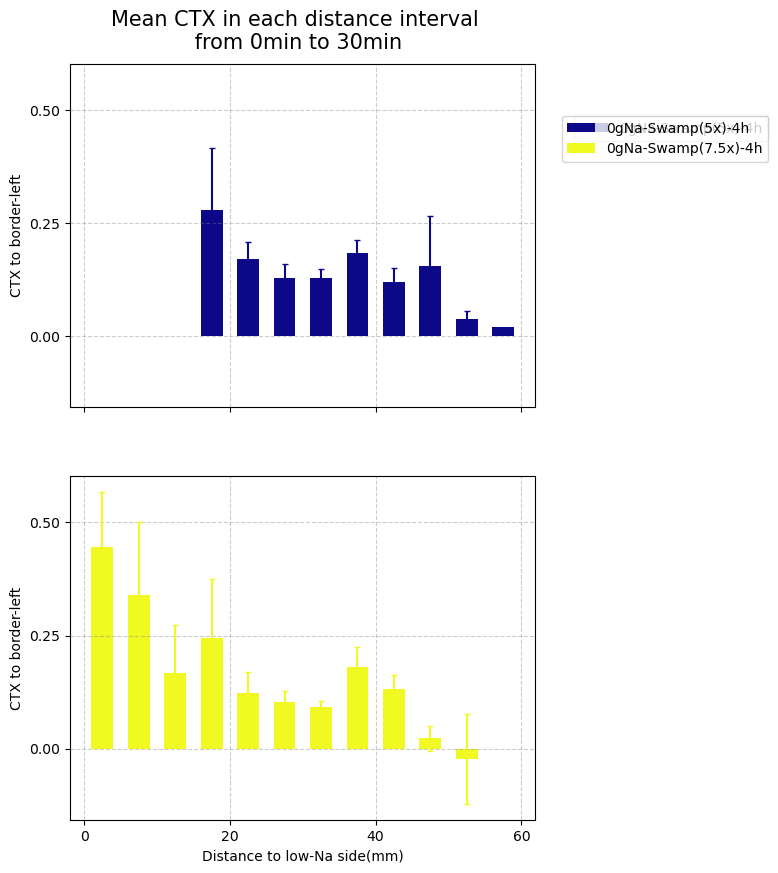

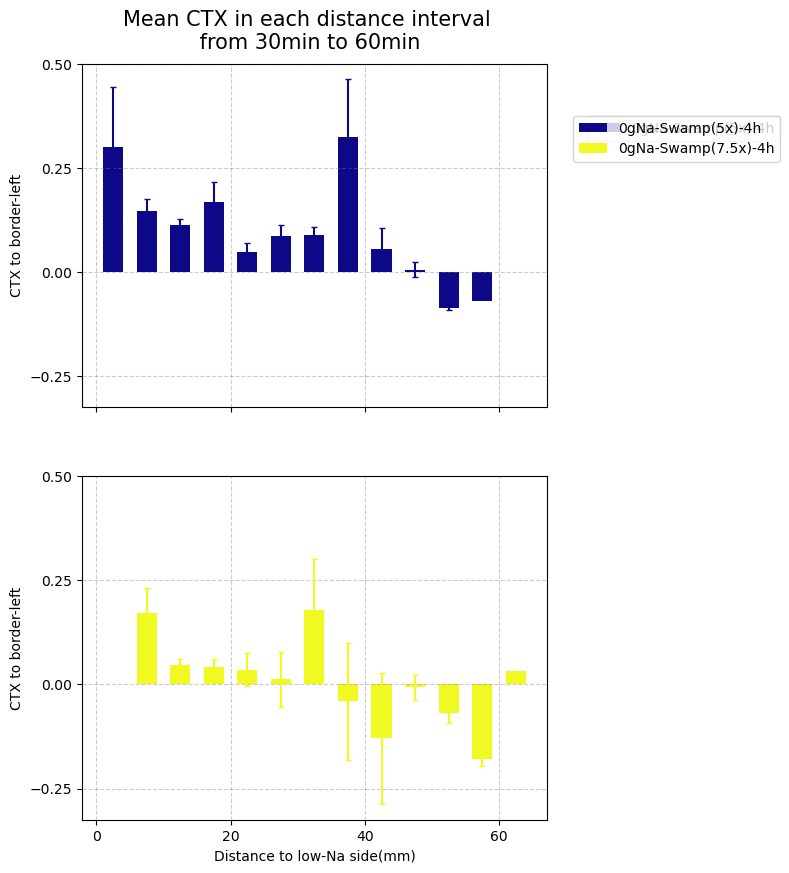

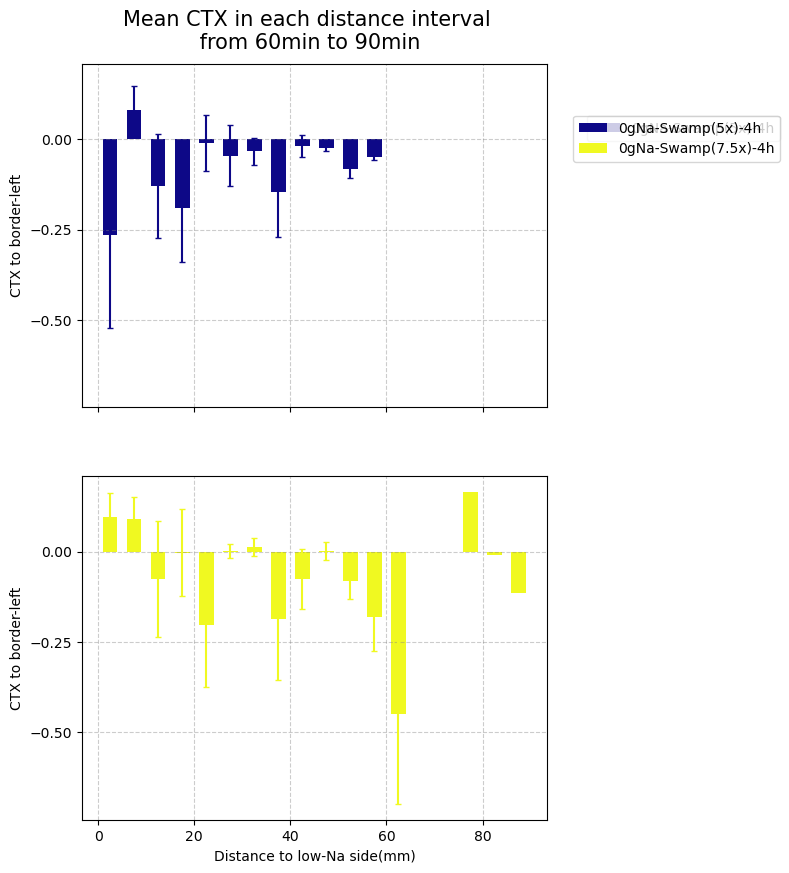

In [210]:
CTX_left_bar_dist_btw_conds(df_1104, conds_1104, 30,width = 3, time_len = 1.5, y_lim = [],sharey=True,drop_tune = True, new_folder = new_folder)

In [17]:
# 比较单个时间区间内各个实验组的CTX-left的差异
def mean_CTX_left_btw_cond(df_als, conds,interval = 30,time_len = 1.5, color_map = 'plasma',
                           y_lim = [], new_folder = 0, drop_turn = True,
                           t_inv_idx = np.array([0,1]), y_ticker_spacing = 0.1,
                           spf_title = '', fs = 20, width = 0.75):

    num_inv = int(time_len*60//interval)
    t_inv_vecs = np.array([(interval*i, interval*(i+1)) for i in range(num_inv)])
    t_inv_vec = t_inv_vecs[t_inv_idx]
    
    if drop_turn:
        df_als_new = df_als[df_als.Event == 0]
    else:
        df_als_new = df_als

    for t_inv in t_inv_vec:
        # 筛选时间
        frame_per_min = int(max(df_als_new['Timestamp'])/(time_len*60))
        start_timestamp = t_inv[0]*frame_per_min
        end_timestamp = t_inv[1]*frame_per_min
#         print(f'start to end:{start_timestamp}and{end_timestamp}')
        df_time_j = df_als_new[(df_als_new.Timestamp >= start_timestamp) & (df_als_new.Timestamp < end_timestamp)]

        # color
        conds_vec = [i for i in range(len(conds))]
        conds_vec_norm = conds_vec/np.max(conds_vec)
        colormap = mpl.colormaps[color_map]
        colors = colormap(conds_vec_norm)
        color_dict = {conds[i]:colors[i] for i in range(len(conds))}
        print(color_dict)
        # 根据conds进行排序，美化图片
        df_time_j['Condition'] = pd.Categorical(df_time_j['Condition'], categories=conds, ordered=True)
        df_time_j_sorted = df_time_j.sort_values(by = 'Condition')

        # 根据condtion分类作图
        # *代码思路：根据condition分组之后作图
        fig, ax = plt.subplots(1,1, figsize=(6,4))

        # 循环绘制每个condition的bar
        j = 0
        for condition, group in df_time_j_sorted.groupby(by='Condition', observed=True):
            mean_CTX_each_g = group.groupby('Group_id')['CTX_left'].mean().reset_index()
            group_num = len(group.Group_id.unique())       # 每个condition的group数量
            std_CTX = mean_CTX_each_g.CTX_left.std()
            mean_CTX = mean_CTX_each_g.CTX_left.mean()
            sem_CTX = std_CTX/np.sqrt(group_num)

            ax.grid(linestyle = 'dashed', color = 'grey', alpha = 0.4, which = 'both',axis = 'y')
            ax.bar(j,mean_CTX,width=width,yerr =sem_CTX,ecolor = color_dict[conds[j]], capsize = 2, alpha = 1, color = color_dict[condition])
            ax.set_ylabel('CTX to border-left', fontsize = fs*0.85)
    #         ax.xaxis.set_major_locator(ticker.MultipleLocator(x_ticker_spacing))
            ax.yaxis.set_major_locator(ticker.MultipleLocator(y_ticker_spacing))
            j+=1
        if y_lim:
            ax.set_ylim(y_lim[0], y_lim[1])
    #     fig.legend(bbox_to_anchor = (1.15,0.9))
        j += 1
        plt.title(f'Mean CTX to border-left\n from {t_inv[0]}min to {t_inv[1]}min', y=1.01, fontsize=fs)
        plt.xticks(np.arange(len(conds)), conds, rotation = 30, fontsize = fs*0.75)
        if new_folder:
        #  保存图片
            title_name = spf_title+'Mean CTX-left_from'+str(t_inv[0])+' to '+str(t_inv[1])+'min'+'.png'
            file_path = os.path.join(new_folder, title_name)
            plt.savefig(file_path,bbox_inches='tight')
        else:
            plt.show()

{'0gNa(end)-Swamp': array([0.050383, 0.029803, 0.527975, 1.      ]), '0gNa-Swamp-8h': array([0.610667, 0.090204, 0.619951, 1.      ]), '4.5gNa(end)-Swamp': array([0.928329, 0.472975, 0.326067, 1.      ]), '4.5gNa-Swamp-8h': array([0.940015, 0.975158, 0.131326, 1.      ])}


C:\Users\Windows11\AppData\Local\Temp\ipykernel_20224\3188677998.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_time_j['Condition'] = pd.Categorical(df_time_j['Condition'], categories=conds, ordered=True)


{'0gNa(end)-Swamp': array([0.050383, 0.029803, 0.527975, 1.      ]), '0gNa-Swamp-8h': array([0.610667, 0.090204, 0.619951, 1.      ]), '4.5gNa(end)-Swamp': array([0.928329, 0.472975, 0.326067, 1.      ]), '4.5gNa-Swamp-8h': array([0.940015, 0.975158, 0.131326, 1.      ])}


C:\Users\Windows11\AppData\Local\Temp\ipykernel_20224\3188677998.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_time_j['Condition'] = pd.Categorical(df_time_j['Condition'], categories=conds, ordered=True)


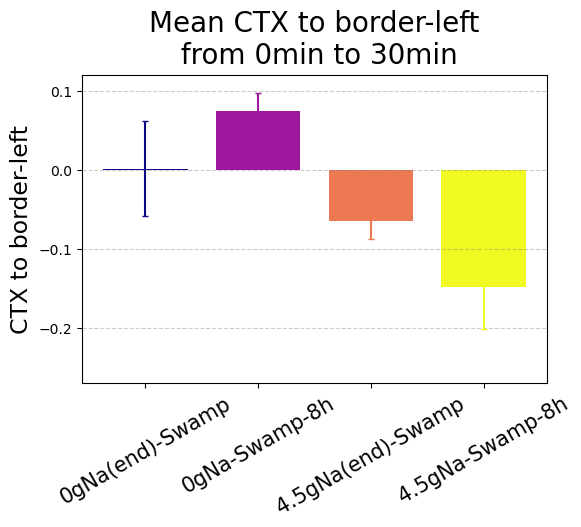

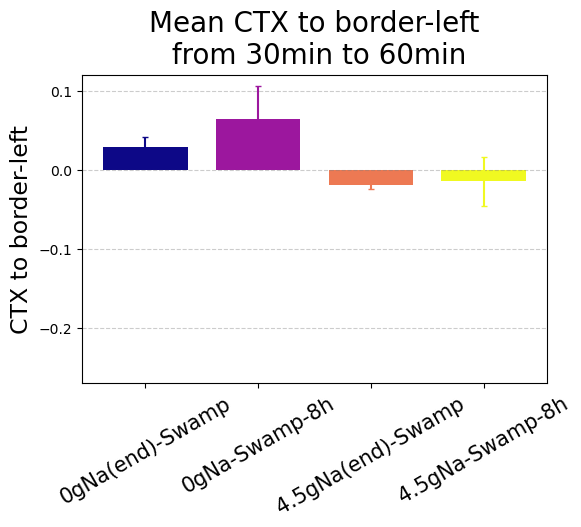

In [18]:
mean_CTX_left_btw_cond(df_1111, conds_1111, interval = 30,time_len = 3,y_lim=[-0.27, 0.12], new_folder=new_folder)

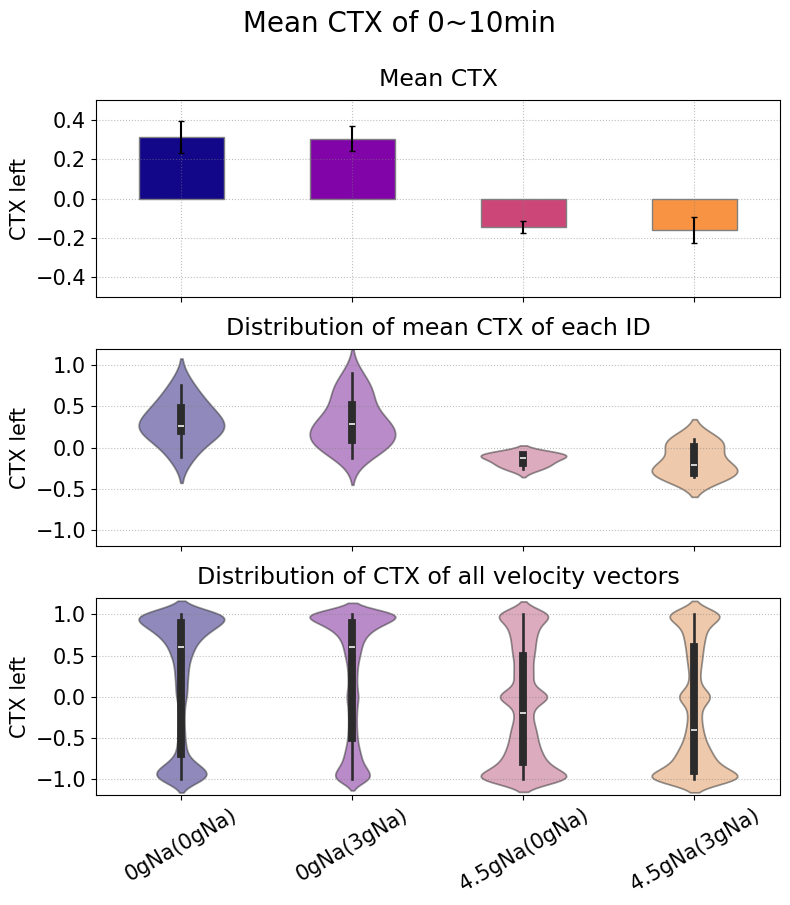

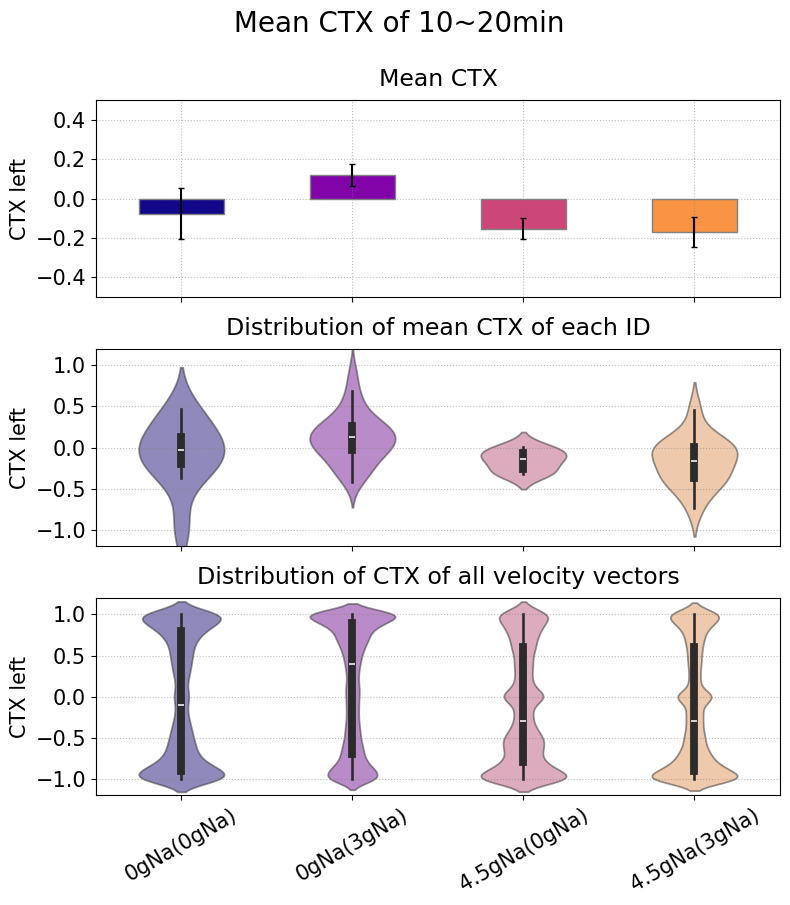

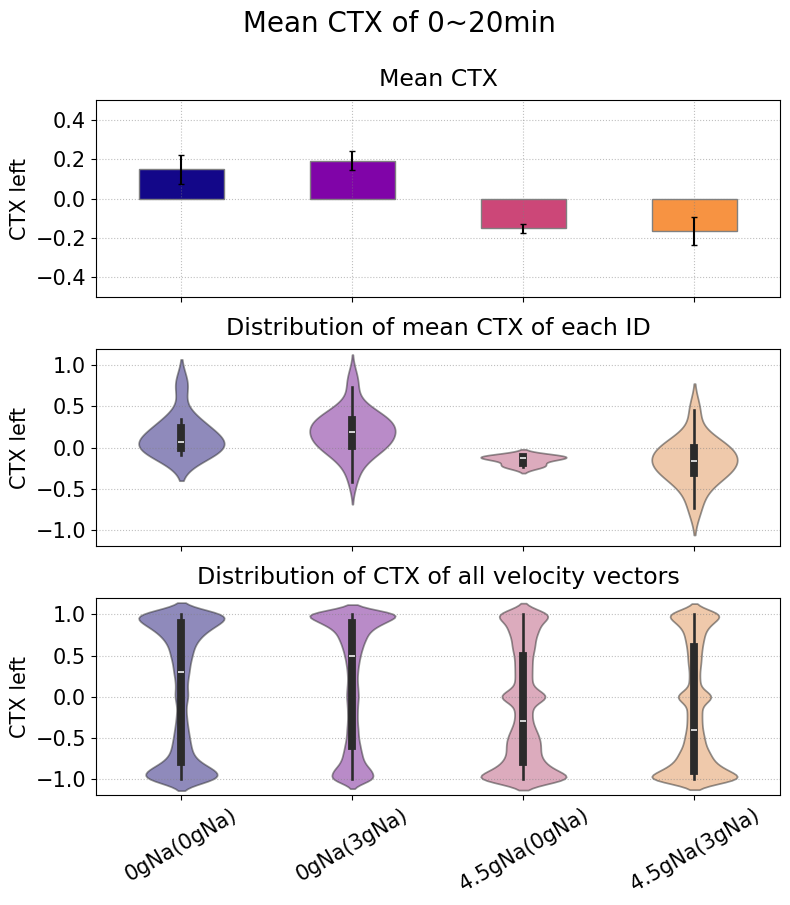

In [28]:
# 比较单个时间区间内各个实验组的CTX-left的差异
# 三行子图，分别作均值柱状图， 均值分布提琴，CTX分布提琴图

df = df_1213_li.copy()
conds = conds_1213_li
key_word = ''
color_dict = {}
t_inv_vec = [(0,10),(10,20),(0,20)]
interval = 15
time_len = 1
sharey = False
color_map = 'plasma'
y_lim_1 = [-0.5,0.5]
y_lim_23 = [-1.2,1.2]
new_folder = new_folder
drop_turn = True
y_ticker_spacing = 0.1
fs = 20
width = 0.5

if len(t_inv_vec):
    # 如果定义了时间区间，直接使用
    pass
else:
    # 如果没有定义，根据interval生成所有区间并循环作图
    t_inv_vec = []
    i = 0
    t_inv = [i*interval, interval*(i+1)]    # 第一个计算时间区间
    t_inv_vec.append(t_inv)
    while t_inv[1]<unpper_bound:
        i += 1
        t_inv = (i*slide_win, i*slide_win+interval)
        t_inv_vec.append(t_inv)
num_inv = len(t_inv_vec)

    
# date生成color_dict.可直接输入color_dict
if color_dict:
    pass
else:
    color_vec_norm = np.linspace(0.01,0.99,len(conds)+1)
    colormap = mpl.colormaps[color_map]
    colors  = colormap(color_vec_norm)
    color_dict = {}
    for i, d in enumerate(conds):
        color_dict[d] = colors[i]
if drop_turn:
    df = df[df.Event == 0]

df['Condition'] = pd.Categorical(df['Condition'], categories=conds, ordered=True)
df.sort_values(by ='Condition')

# 每个时间一张图
for t_inv in t_inv_vec:
    # 筛选时间
    frame_per_min = int(max(df['Timestamp'])/(time_len*60))
    start_timestamp = t_inv[0]*frame_per_min
    end_timestamp = t_inv[1]*frame_per_min

    df_time_j = df[(df.Timestamp >= start_timestamp) & (df.Timestamp < end_timestamp)]
    
    # 同一时间段的不同date_cond下，合并replica，errorbar为ID的CTX均值的标准误
    mean_CTX_each_g = df_time_j.groupby(['Condition','Group_id','ID']).agg({'CTX_left':'mean'}).reset_index()

    mean_CTX_each_d_c = mean_CTX_each_g.groupby('Condition')['CTX_left'].agg(['mean','sem']).reset_index()
    mean_CTX_each_d_c['Condition'] = mean_CTX_each_d_c['Condition'].astype(str)
    mean_CTX_each_d_c['color'] = mean_CTX_each_d_c['Condition'].map(color_dict)
    
    
    # 作图
    fig,ax = plt.subplots(3,1, figsize=(len(conds)*2, 9), sharex = True,sharey=sharey, tight_layout=True)
#     plt.grid(linestyle=':', color = 'grey', alpha=0.5)
    plt.suptitle(f'{key_word} Mean CTX of {t_inv[0]}~{t_inv[1]}min', fontsize=fs,y=1.)
    
    # 第一行，CTX均值柱状图
    ax[0].set_title('Mean CTX',fontsize=fs*0.85, pad=fs*0.5)
    ax[0].grid(linestyle=':', color = 'grey', alpha=0.5)
    ax[0].bar(mean_CTX_each_d_c.index, mean_CTX_each_d_c['mean'], yerr = mean_CTX_each_d_c['sem'], width=width, edgecolor='grey',capsize=2,color = mean_CTX_each_d_c['color'] )
    ax[0].set_ylabel('CTX left',fontsize=fs*0.75)
    ax[0].tick_params(labelsize=fs*0.75, axis='y')
    if y_lim_1:
        ax[0].set_ylim(y_lim_1[0], y_lim_1[1])
    # 第二行，CTX均值分布图
    ax[1].set_title('Distribution of mean CTX of each ID',fontsize=fs*0.85, pad=fs*0.5)
    ax[1].grid(linestyle=':', color = 'grey', alpha=0.5)
    sns.violinplot(data=mean_CTX_each_g, x = 'Condition', hue='Condition', y='CTX_left',width=width, legend=False,alpha=0.5, palette=list(mean_CTX_each_d_c['color'].values),ax=ax[1])
    ax[1].set_ylabel('CTX left',fontsize=fs*0.75)
    ax[1].tick_params(labelsize=fs*0.75, axis='y')
    # 第三行
    ax[2].set_title('Distribution of CTX of all velocity vectors',fontsize=fs*0.85, pad=fs*0.5)
    ax[2].grid(linestyle=':', color = 'grey', alpha=0.5)
    sns.violinplot(data = df_time_j, x='Condition', hue='Condition', y='CTX_left',width=width,alpha=0.5,legend=False, palette=list(mean_CTX_each_d_c['color'].values), ax=ax[2])
    ax[2].set_ylabel('CTX left',fontsize=fs*0.75)
    
    # 删除轴标签并自定义内容和大小
    for axs in ax[1:]:  # 针对第二和第三行
        axs.set_xlabel('')
        if y_lim_23:
            axs.set_ylim(y_lim_23[0], y_lim_23[1])
    for axs in ax:
        axs.yaxis.set_major_locator(MaxNLocator(nbins=5))  # 设定最大5个刻度
    # 调整全局的 x 和 y 刻度标签大小
    for axs in ax:
#         ax.tick_params(axis='x', labelsize=fs*0.5)  # 统一调整 x 轴标签大小
        axs.tick_params(axis='y', labelsize=fs*0.75)  # 统一调整 y 轴标签大小
    ax[2].set_xticks(mean_CTX_each_d_c.index, mean_CTX_each_d_c['Condition'],rotation=30, fontsize=fs*0.75)
    plt.subplots_adjust(hspace=0.1)

    if new_folder:
    #  保存图片
        title_name = key_word+'CTX-left_from'+str(t_inv[0])+' to '+str(t_inv[1])+'min'+'.png'
        file_path = os.path.join(new_folder, title_name)
        plt.savefig(file_path,bbox_inches='tight')
    else:
        plt.show()

# Sharp Turn相关分析

计算Turning Rate随时间变化

In [25]:
def cal_turn_and_run(df_e,which='Pirouette', min_agl_spd=None, frame_length = 0.025, folder=0,frame_rate=20) :
# 输入：同一个id的df， 指定计算的事件类型('Event'或'Pirouette')
# 输出：返回这一段id的turning rate（float）和所有的run_len（array格式）
# 备注：1）如果输入min_agl_spd可以重新对Event进行分类
#       2）需要配合cal_df_turn_by_id()等按照ID分组后喂给该函数输入，并接收输出的函数
    if min_agl_spd:
        # 提取Event序列
        if 'Event' in df_e.columns:
            df_e.drop('Event', axis=1)   
        df_e.loc[(df_e.agl_speed >= min_agl_spd),'Event'] = 1
        df_e.loc[(df_e.agl_speed < min_agl_spd),'Event'] = 0
    
    # 将timestamp归一化
    df_e.loc[:, 'Timestamp'] = df_e['Timestamp']-df_e['Timestamp'].min()

    event_vec = df_e[which]
    # nan值是计算速度和角速度时舍弃的点，默认是0不计算
    event_vec = event_vec.fillna(0).values
    # 向后移动一位，上下相减
    diff_vec = event_vec[1:]-event_vec[:-1]
    
    if (diff_vec==0).all():
#         print('该id没有turn!')    # 理论上也可能是没有run,但是不太可能，放掉这个bug
        
        run_lens = df_e.Timestamp.max()-df_e.Timestamp.min()
        num_turn = 0
        
        return num_turn, np.array([run_lens])
    elif ~(diff_vec==1).any() or ~(diff_vec==-1).any():
        # 这里需要修改！！！！！！！
        run_lens = df_e.Timestamp.max()-df_e.Timestamp.min()
        return 0, np.array([run_lens])
    else:
        
        # 统计所有出现1和-1的索引
        idx_1 = np.where(diff_vec == 1)[0]
        idx_n1 = np.where(diff_vec == -1)[0]
#         print('idx_vec of 1', idx_1)
#         print('idx_vec of -1', idx_n1)
        if np.min(idx_1)<np.min(idx_n1):
            # 如果最小的索引是1而不是-1，说明开头是run，然后才开始出现turn
            if len(idx_1)>len(idx_n1):
                # 如果1的数量大于-1,说明最后一个turn没有结束
#                 print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
                # idx_n1首部加一个0，用1的索引减前一个-1的索引
                idx_n1 = np.append(0,idx_n1)
                run_lens = idx_1-idx_n1[:]
#                 print('run_length:', run_lens)
            elif len(idx_1)==len(idx_n1):
                # 如果两者数量相同，说明最后以run结尾，这条轨迹前后是完整的多个turn
#                 print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
                # idx_n1首部加一个0，用1的索引减前一个-1的索引
                idx_n1 = np.append(0,idx_n1)
                run_lens = idx_1-idx_n1[:-1]
                # 在加上最后一个turn结束后的run的长度
                len_last_run = len(diff_vec)-idx_n1[-1]
                run_lens = np.append(run_lens, len_last_run)
#                 print('run_length:', run_lens)
            # 无论是上述哪种情况，turn的数量都记为出现1的数量
            num_turn = len(idx_1)
#             print(f'Turn number: {num_turn}')
        elif np.min(idx_1)>np.min(idx_n1):
            # 如果最小索引是-1而不是1，说明开头就是turn
            if (len(idx_n1)== len(idx_1)+1):
                # 如果-1比1多一个，说明以run结尾
#                 print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
                # 直接去掉最后一个-1，计算len长度
                run_lens = idx_1-idx_n1[:-1]
                len_last_run = len(diff_vec)-idx_n1[-1]
                run_lens = np.append(run_lens, len_last_run)
#                 print('run_length:', run_lens)
            elif (len(idx_n1) == len(idx_1)):
                # 如果-1和1一样多，说明以turn结尾
#                 print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
                run_lens = idx_1-idx_n1[:]
#                 print('run_length:', run_lens)
            # 无论哪种情况，turn的数量都是1的数量加一
            num_turn = len(idx_1)+1
#             print(f'Turn number: {num_turn}')
        return num_turn, run_lens

def cal_df_turn_by_id(df, mas=65,which='Pirouette', frame_rate=20, folder=0):
# 输入id不重合的df
# 输出：所有id对应的TimeLen, TurningRate, RuneLen的df_turn
    df_turn = pd.DataFrame({})
    for g_id, g_df in df.groupby('ID'):
        time_len = (g_df.Timestamp.max()-g_df.Timestamp.min())/frame_rate
        n_turn_i, run_len_i = cal_turn_and_run(g_df,which=which,min_agl_spd=mas, folder=folder, frame_rate=frame_rate)

        turn_data = pd.DataFrame({
            'ID': [g_id],
            'TimeLen':[time_len] ,
            'TurningRate': [n_turn_i/time_len]
        })

        run_data = pd.DataFrame({
            'ID':g_id,  
            'RunLen':run_len_i
        })

        turn_run_data = pd.merge(turn_data, run_data, on='ID', how='outer')
        df_turn = pd.concat([df_turn, turn_run_data], join='outer', ignore_index = True)
    return df_turn

In [26]:
# def cal_turn_and_run(df_e,which='Pirouette', min_agl_spd=None, frame_length = 0.025, folder=0,frame_rate=20) :
# # 输入：同一个id的df， 指定计算的事件类型('Event'或'Pirouette')
# # 输出：返回这一段id的turning rate（float）和所有的run_len（array格式）
# # 备注：1）如果输入min_agl_spd可以重新对Event进行分类
# #       2）需要配合cal_df_turn_by_id()等按照ID分组后喂给该函数输入，并接收输出的函数
#     if min_agl_spd:
#         # 提取Event序列
#         if 'Event' in df_e.columns:
#             df_e.drop('Event', axis=1)   
#         df_e.loc[(df_e.agl_speed >= min_agl_spd),'Event'] = 1
#         df_e.loc[(df_e.agl_speed < min_agl_spd),'Event'] = 0
    
#     # 将timestamp归一化
#     df_e.loc[:, 'Timestamp'] = df_e['Timestamp']-df_e['Timestamp'].min()

#     event_vec = df_e[which]
#     # nan值是计算速度和角速度时舍弃的点，默认是0不计算
#     event_vec = event_vec.fillna(0).values
#     # 向后移动一位，上下相减
#     diff_vec = event_vec[1:]-event_vec[:-1]
    
#     if (diff_vec==0).all():
# #         print('该id没有turn!')    # 理论上也可能是没有run,但是不太可能，放掉这个bug
        
       
#         run_lens = df_e.Timestamp.max()-df_e.Timestamp.min()
#         num_turn = 0
        
#         return num_turn, np.array([run_lens])
#     elif ~(diff_vec==1).any():
#         # 没有1但是有-1，说明开头就是turn，之后都是run
#         idx_n1 = np.where(diff_vec == -1)[0]
#         run_lens = len(diff_vec)-idx_n1[0]
        
#         return 1, np.array([run_lens])
#     elif ~(diff_vec==-1).any():
#         # 没有-1但是有1，说明开头就是run，结尾是turn
#         idx_1 = np.where(diff_vec == 1)[0]
#         run_lens = idx_1[0]
#         return 1, np.array([run_lens])
#     else:
        
#         # 统计所有出现1和-1的索引
#         idx_1 = np.where(diff_vec == 1)[0]
#         idx_n1 = np.where(diff_vec == -1)[0]
#         print('idx_vec of 1', idx_1)
#         print('idx_vec of -1', idx_n1)
#         if np.min(idx_1)<np.min(idx_n1):
#             # 如果最小的索引是1而不是-1，说明开头是run，然后才开始出现turn
#             if len(idx_1)>len(idx_n1):
#                 # 如果1的数量大于-1,说明最后一个turn没有结束
#                 print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
#                 # idx_n1首部加一个0，用1的索引减前一个-1的索引
#                 idx_n1 = np.append(0,idx_n1)
#                 run_lens = idx_1-idx_n1[:]
#                 print('run_length:', run_lens)
#             elif len(idx_1)==len(idx_n1):
#                 # 如果两者数量相同，说明最后以run结尾，这条轨迹前后是完整的多个turn
#                 print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
#                 # idx_n1首部加一个0，用1的索引减前一个-1的索引
#                 idx_n1 = np.append(0,idx_n1)
#                 run_lens = idx_1-idx_n1[:-1]
#                 # 在加上最后一个turn结束后的run的长度
#                 len_last_run = len(diff_vec)-idx_n1[-1]
#                 run_lens = np.append(run_lens, len_last_run)
#                 print('run_length:', run_lens)
#             # 无论是上述哪种情况，turn的数量都记为出现1的数量
#             num_turn = len(idx_1)
#             print(f'Turn number: {num_turn}')
#         elif np.min(idx_1)>np.min(idx_n1):
#             # 如果最小索引是-1而不是1，说明开头就是turn
#             if (len(idx_n1)== len(idx_1)+1):
#                 # 如果-1比1多一个，说明以run结尾
#                 print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
#                 # 直接去掉最后一个-1，计算len长度
#                 run_lens = idx_1-idx_n1[:-1]
#                 len_last_run = len(diff_vec)-idx_n1[-1]
#                 run_lens = np.append(run_lens, len_last_run)
#                 print('run_length:', run_lens)
#             elif (len(idx_n1) == len(idx_1)):
#                 # 如果-1和1一样多，说明以turn结尾
#                 print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
#                 run_lens = idx_1-idx_n1[:]
#                 print('run_length:', run_lens)
#             # 无论哪种情况，turn的数量都是1的数量加一
#             num_turn = len(idx_1)+1
#             print(f'Turn number: {num_turn}')
#         return num_turn, run_lens

In [26]:
def mean_turningrate_of_df_turn(df, which='Pirouette'):
    if which=='Pirouette':
        df= Label_Pirouettes(df,t_crit=6.16, min_agl_spd=65)
    df_turn = cal_df_turn_by_id(df, mas=65, which=which)
    df_tr_by_id = df_turn.groupby('ID').agg({'TimeLen':'mean', 'TurningRate':'mean'}).reset_index()
    mean_df_tr = np.dot(df_tr_by_id['TurningRate'].values, df_tr_by_id['TimeLen'].values)/df_tr_by_id['TimeLen'].sum()
    print(mean_df_tr)
    return pd.Series({'Mean_TurningRate':mean_df_tr})

In [27]:
def mean_turningrate_of_id(df, which='Pirouette', min_agl_spd=65, frame_rate = 20):
# 输入：单个id的df
    # df必须先分成单个id输入才能标记Pirouette!
    if df.empty:
        print('empty df!')
        return pd.Series({'TurningRate': 'empty', 'TimeLen': 'empty'})
    else:
        if which=='Pirouette':
            df= Label_Pirouettes_by_id(df,t_crit=6.16, min_agl_spd=65)
        num_turn,__ = cal_turn_and_run(df,which=which, min_agl_spd=min_agl_spd, frame_rate = frame_rate)
        time_len = (df.Timestamp.max()-df.Timestamp.min())/frame_rate
        turningrate_i = num_turn/time_len
#         print(f'该ID的turn数量为{num_turn}个,总时长为{time_len}s')
        result = pd.Series({'TurningRate':turningrate_i, 'TimeLen':time_len})        
        return result

In [28]:
def weigthed_mean_turning_rate(df, value_col, weight_col):
    # 输入包含TimeLen和TurningRate的df
    # 返回根据TimeLen加权的平均TurningRate
    weighted_mean = (df[value_col] * df[weight_col]).sum() / df[weight_col].sum()
    numerator = np.sqrt((df[weight_col]**2 * (df[value_col]-weighted_mean)**2).sum())
    weighted_sem = numerator/df[weight_col].sum()
    return pd.Series({'Weighted_mean':weighted_mean, 'Weighted_sem':weighted_sem})

0gNa-Swamp-8h
只有结尾有turn或只有开头有turn
只有结尾有turn或只有开头有turn


ZeroDivisionError: float division by zero

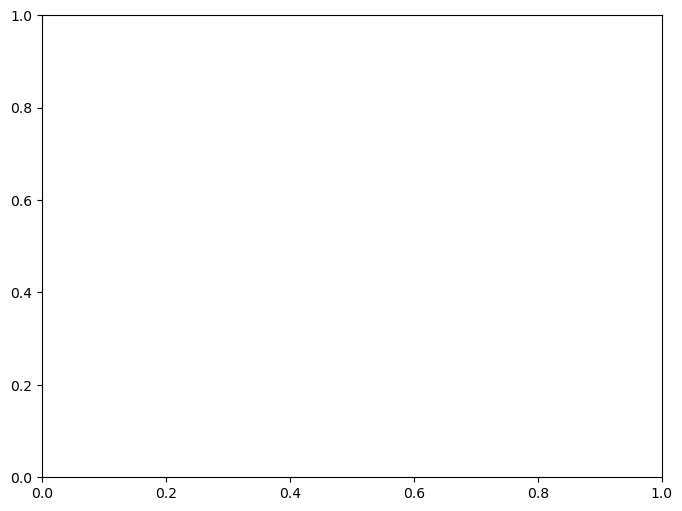

In [32]:
# errorbar根据一个condition下(所有groups的)每个id的TurningRate以及它们的加权标准误绘制
df = df_1121.copy()
conds = conds_1121
color_map = 'plasma'
time_len = 3    # h
time_inv = 10       # min
ls = 15
fs = 20
lw = 2
angle = 45
frame_length = 0.025  # mm
frame_rate = 20


# 灵活设置时间间隔
num_frames = time_len*3600*frame_rate
periods = np.arange(0,time_len*60+1,time_inv)
periods_timestamp = np.arange(0, num_frames+1, time_inv*60*frame_rate)
labels = [(periods[i] + periods[i + 1]) / 2 for i in range(len(periods) - 1)]
df['Period_label'] = pd.cut(df['Timestamp'], bins=periods_timestamp, labels=labels, right=False,include_lowest=True)   # right=False表示区间左闭右开

# 设置颜色字典
color_dict = {}
if color_dict:
    pass
else:
    color_vec_norm = np.linspace(0.001,0.999,len(conds)+1)
    colormap = mpl.colormaps[color_map]
    colors  = colormap(color_vec_norm)
    color_dict = {}
    for i, d in enumerate(conds):
        color_dict[d] = colors[i]
        
fig,ax = plt.subplots(1,1, figsize = (8,6))        # (7,6) or(6,8)

for j in range(len(conds)):
    # 每个condition分别做图
    print(conds[j])
    df_cond = df[df['Condition']==conds[j]]
    # 计算每个id的平均TurningRate和每个id的时长
#     for g, g_df in df_cond.groupby('Group_id'):
    df_mean_tr_by_id = df_cond.groupby(['Group_id','ID','Period_label']).apply(mean_turningrate_of_id).reset_index()
    # 计算加权均值
    df_weigthed_tr_by_prd = df_mean_tr_by_id.groupby('Period_label').apply(lambda x: weigthed_mean_turning_rate(x, 'TurningRate','TimeLen')).reset_index()
    ax.errorbar(df_weigthed_tr_by_prd['Period_label'], df_weigthed_tr_by_prd['Weighted_mean'], yerr = df_weigthed_tr_by_prd['Weighted_sem'],fmt = 'None', ecolor = color_dict[conds[j]], capsize = 2, linewidth = lw)
    ax.plot(df_weigthed_tr_by_prd['Period_label'], df_weigthed_tr_by_prd['Weighted_mean'], color = color_dict[conds[j]], marker = 'o',markersize = 2.5, label = str(conds[j]), linewidth = lw)
plt.title('Mean TurningRate Across Time', fontsize = fs)
plt.xlabel('Time(min)', fontsize=fs*0.85)
plt.ylabel('TurningRate', fontsize=fs*0.85)
plt.tick_params(labelsize = fs*0.75)
plt.grid(color = 'grey', linestyle = 'dashed', alpha=0.4, axis='y')
plt.legend(bbox_to_anchor = (1.02,0.95), fontsize=fs*0.75)
plt.show()  


统计Run

In [ ]:
def Label_run_cal_turn_by_id(df, min_agl_spd=None,run_idx = 0, which='Event', frame_rate=20):
# 输入： 完整的来自一个实验组数据的df（包含‘Event'或'Pirouette'列）,id不重复，如果需要重新分turn，输入mas(min_agl_spd)
# 注意，如何在循环中调用并且需要合并数据，可以传入初始化的run_idx
# 输出： 所有id的TurningRate, RunID用于后续分析作图。包含df中所有run的按顺序编号
    
    if min_agl_spd:
        # 提取Event序列
        if 'Event' in df.columns:
            df.drop('Event', axis=1)  
        df.loc[:,'Event'] = 0
        df.loc[(df.agl_speed >= min_agl_spd),'Event'] = 1
        
    df_turn = pd.DataFrame({})
#     print('initial run idx=', run_idx)
    
    for g_id, g_df in df.groupby('ID'):
        
        g_df = g_df.reset_index(drop=True)
        # id总时长，用于计算turning rate
        time_len = (g_df.Timestamp.max()-g_df.Timestamp.min())/frame_rate
        event_vec = g_df[which]
        # nan值是计算速度和角速度时舍弃的点，默认是0不计算
        event_vec = event_vec.fillna(0).values
        # 向后移动一位，上下相减
        diff_vec = event_vec[1:]-event_vec[:-1]

        # 如果没有turn存在
        if (diff_vec==0).all():
#             print('该id没有turn!')    # 理论上也可能是没有run,但是不太可能，放掉这个bug
            
#             # run的长度
#             run_lens = df_e.Timestamp.max()-df_e.Timestamp.min()
            # turn的数量为0
            num_turn = 0
            
            # run编号后加1(如果计算了run的编号，run_len能够在后续分析时很容易计算，不再重复增加RunLen项)
            g_df.loc[:,'RunID'] = run_idx
            run_idx += 1
        elif ~(diff_vec==1).any():
            # 只有开头有turn
            idx_n1 = np.where(diff_vec == -1)[0]
            g_df.loc[idx_n1[0]+1:, 'RunID']=run_idx
            run_idx += 1
            num_turn = 1
        elif ~(diff_vec==-1).any():
            # 只有结尾有turn
            idx_1 = np.where(diff_vec == 1)[0]
            g_df.loc[0:idx_1[0]+1, 'RunID']=run_idx
            run_idx += 1
            num_turn = 1
        else:
            # 统计所有出现1和-1的索引
            idx_1 = np.where(diff_vec == 1)[0]
            idx_n1 = np.where(diff_vec == -1)[0]
            if np.min(idx_1)<np.min(idx_n1):
                # 如果最小的索引是1而不是-1，说明开头是run，然后才开始出现turn
                if len(idx_1)>len(idx_n1):
                    # 如果1的数量大于-1,说明最后一个turn没有结束
#                     print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
                    # idx_n1首部加一个0，用1的索引减前一个-1的索引
                    idx_n1 = np.append(0,idx_n1)
#                     run_lens = idx_1-idx_n1[:]
#                     print('run_length:', run_lens)
                    
                    # 给run编号(从-1的索引加1到1的索引加1)
                    for i,n1 in enumerate(idx_n1):
                        if n1==0:
                            g_df.loc[n1:idx_1[i]+1, 'RunID'] = run_idx
                        else:
                            g_df.loc[idx_n1[i]+1:idx_1[i]+1, 'RunID']=run_idx
                        run_idx += 1
                    # 给turn编号（略）
                    
                elif len(idx_1)==len(idx_n1):
                    # 如果两者数量相同，说明最后以run结尾，这条轨迹前后是完整的多个turn
#                     print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')
                    # idx_n1首部加一个0，用1的索引减前一个-1的索引
                    idx_n1 = np.append(0,idx_n1)
                    # 给run编号
                    for i,n1 in enumerate(idx_n1):
                        if n1 == 0:                  
                            # 第一个run
                            g_df.loc[n1:idx_1[i]+1, 'RunID'] = run_idx
                        elif i == (len(idx_n1) - 1):
                            g_df.loc[idx_n1[i] + 1:, 'RunID'] = run_idx
                        else:
                            g_df.loc[idx_n1[i]+1:idx_1[i]+1, 'RunID']=run_idx
                        run_idx += 1
                     
                # 无论是上述哪种情况，turn的数量都记为出现1的数量
                num_turn = len(idx_1)
#                 print(f'Turn number: {num_turn}')
            elif np.min(idx_1)>np.min(idx_n1):
                # 如果最小索引是-1而不是1，说明开头就是turn
                if (len(idx_n1)== len(idx_1)+1):
                    # 如果-1比1多一个，说明以run结尾
#                     print(f'验证最后是否以run结束:{(np.max(idx_n1)>np.max(idx_1))}')                   
                    # 给run编号
                    for i,n1 in enumerate(idx_n1):
                        
                        if i == len(idx_n1)-1:   # 最后一个run
                            g_df.loc[idx_n1[i]+1:, 'RunID'] = run_idx
                        else:
                            g_df.loc[idx_n1[i]+1:idx_1[i]+1, 'RunID']=run_idx
                        run_idx += 1
                        
                elif (len(idx_n1) == len(idx_1)):
                    # 如果-1和1一样多，说明以turn结尾
#                     print(f'验证最后是否以turn结束:{(np.max(idx_n1)<np.max(idx_1))}')
                    # 给run编号
                    for i,n1 in enumerate(idx_n1):
                        g_df.loc[idx_n1[i]+1:idx_1[i]+1, 'RunID']=run_idx
                        run_idx += 1
                # 无论哪种情况，turn的数量都是1的数量加一
                num_turn = len(idx_1)+1
#                 print(f'Turn number: {num_turn}')
        g_df.loc[:,'ID']=g_id
        g_df.loc[:,'TurningRate']=num_turn/time_len    # 个/s
        g_df.loc[:,'TimeLen']=time_len     # sec
        df_turn = pd.concat([df_turn, g_df], join='outer', ignore_index = True)
        
    return df_turn, run_idx

NameError: name 'Label_run_cal_turn_by_id' is not defined

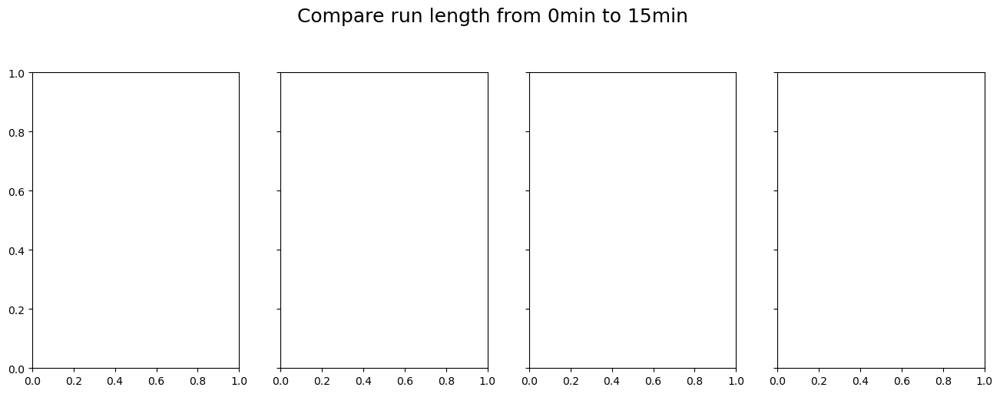

In [30]:
df = df_1121.copy()
conds = conds_1121
time_len = 3
fs = 18
width=0.6
up_bound = 0.5
low_bound = -0.5
cs = 2
# t_inv_vec = []
t_inv_vec = [(0,15),(15,30),(0,30),(30,60)]
# t_inv_vec = []
interval = 30

y_lim = []

if len(t_inv_vec):
    # 如果定义了时间区间，直接使用
    pass
else:
    # 如果没有定义，根据interval生成所有区间并循环作图
    t_inv_vec = []
    i = 0
    t_inv = [i*interval, interval*(i+1)]    # 第一个计算时间区间
    t_inv_vec.append(t_inv)
    while t_inv[1]<unpper_bound:
        i += 1
        t_inv = (i*slide_win, i*slide_win+interval)
        t_inv_vec.append(t_inv)
num_inv = len(t_inv_vec)

df['Condition'] = pd.Categorical(df['Condition'], categories=conds, ordered=True)
df.sort_values(by ='Condition')

# 每个时间一张图
for t_inv in t_inv_vec:
    # 筛选时间
    frame_per_min = int(max(df['Timestamp'])/(time_len*60))
    start_timestamp = t_inv[0]*frame_per_min
    end_timestamp = t_inv[1]*frame_per_min
    df_time_j = df[(df.Timestamp >= start_timestamp) & (df.Timestamp < end_timestamp)]

    fig,ax = plt.subplots(1,len(conds), figsize = (4*len(conds),5), sharey=True)
    plt.suptitle(f'Compare run length from {t_inv[0]}min to {t_inv[1]}min', fontsize=fs, y=1.05)
    c_i = 0
    for c, df_cond in df_time_j.groupby('Condition'):
        # 一个condition一张子图
        df_label_runs = pd.DataFrame({})
        run_idx_c = 0    # 初始化同一个实验条件下的run_idx
        for g, df_g in df_cond.groupby('Group_id'):
            # 分别对每个实验数据单独标记Pirouette并对run进行标记
            df_g_pt = Label_Pirouettes(df_g, min_agl_spd=65, t_crit=6.16)
            df_g_label_run, run_idx_final = Label_run_cal_turn_by_id(df_g_pt, which='Pirouette', run_idx=run_idx_c)
            df_label_runs = pd.concat([df_label_runs, df_g_label_run[['CTX_right','Timestamp', 'RunID']]], axis=0)
            run_idx_c = run_idx_final
        df_mean_ctx_of_runs = df_label_runs.groupby('RunID').agg({'CTX_right':'mean', 'Timestamp':'count'}).reset_index()
        df_up = df_mean_ctx_of_runs[df_mean_ctx_of_runs.CTX_right>=up_bound]
        df_down = df_mean_ctx_of_runs[df_mean_ctx_of_runs.CTX_right<=low_bound]

        ax[c_i].grid(linestyle='dashed', color='grey', axis='y', alpha=0.5)
        ax[c_i].bar('up', (df_up['Timestamp']/20).mean(), yerr = (df_up['Timestamp']/20).sem(), capsize=cs, color='orange', width=width)
        ax[c_i].bar('down', (df_down['Timestamp']/20).mean(), yerr = (df_down['Timestamp']/20).sem(),capsize=cs,  color='b', width=width)
        ax[c_i].set_title(c, fontsize=fs*0.85)
        ax[c_i].tick_params(labelsize=fs*0.75)

        ax[c_i].set_ylabel('run length(sec)', fontsize=fs*0.75)
        ax[c_i].set_xlabel('migration direction ', fontsize=fs*0.75)
        if y_lim:
            ax[c_i].set_ylim(y_lim[0], y_lim[1])
        c_i += 1
    plt.subplots_adjust(hspace=0.2)
    plt.show()

Moving direction和turning frequency的关系
+ 对bearing angle分组
+ 对于同一个组(如-10~10°)每个数据点，判断下一个数据点属于turn的比例，这个比例乘以 (帧率*60s)就是每分钟的turning frequency

In [ ]:
def find_next_event(df, frame_rate=20, step = 1):
    df = df[['Timestamp', 'Event', 'ID','Bearing_left_label']]
    df_run = df[df.Event==0]
    df_runs_ne = pd.DataFrame({})
    for i, df_run_id in df_run.groupby('ID'):
        # 求该id的run的数据的下一个timestamp
        df_run_id.loc[:,'Timestamp'] = df_run_id.Timestamp+step
        df_id = df[df.ID==i]
        df_id_ne = df_id.copy()
        df_id_ne.loc[:,'Next_event'] = df_id_ne['Event']
        df_run_id = df_run_id.merge(df_id_ne[['Timestamp', "Next_event"]], on='Timestamp', how='left')
        df_runs_ne = pd.concat([df_runs_ne, df_run_id], axis=0)
        # 最后输出包含Next_event列的所有id的run数据的sub_df
    return df_runs_ne

In [31]:
df = df_1121.copy()
conds = conds_1121
time_len = 3
angle_inv = 15
frame_rate = 20
min_agl_spd = 65
re_event = True   # 如果重新分event
radians = True
which = 'Pirouette'     # Pirouette效果似乎比Turning要好
t_crit = 2
fs = 15

# t_inv_vec = []
t_inv_vec = [(0,15),(15,30),(0,30), (30,60)]
interval = 30

y_lim = [0,180]

if len(t_inv_vec):
    # 如果定义了时间区间，直接使用
    pass
else:
    # 如果没有定义，根据interval生成所有区间并循环作图
    t_inv_vec = []
    i = 0
    t_inv = [i*interval, interval*(i+1)]    # 第一个计算时间区间
    t_inv_vec.append(t_inv)
    while t_inv[1]<unpper_bound:
        i += 1
        t_inv = (i*slide_win, i*slide_win+interval)
        t_inv_vec.append(t_inv)
num_inv = len(t_inv_vec)

df['Condition'] = pd.Categorical(df['Condition'], categories=conds, ordered=True)
df.sort_values(by ='Condition')

# 分turning还是Pirouette
if which == 'Event':
    if re_event:
        df = df.drop('Event', axis=1)
        df.loc[df.agl_speed < min_agl_spd,'Event'] = 0
        df.loc[df.agl_speed >= min_agl_spd,'Event'] = 1
    else:
        pass
elif which == 'Pirouette':
    part_Label_Pirouette = partial(Label_Pirouettes, t_crit = t_crit)
    df = df.groupby(['Condition','Group_id']).apply(part_Label_Pirouette).reset_index(drop=True)   # 默认t_crit=6.16s
    df.loc[:,'Event'] = df['Pirouette']    # 把Pirouette赋值给Event方便后续计算

# 合并正逆时针旋转的角度
if radians:
    df.loc[:,'bearing_left'] = ((df.bearing_left)*180/np.pi).abs()   # 转成角度制，并且所有负角度取绝对值
else:
    pass
# 灵活对bearing angle分组
angles_vec = np.arange(0, 180+1, angle_inv)
labels = [(angles_vec[i] + angles_vec[i + 1]) / 2 for i in range(len(angles_vec) - 1)]

df['Bearing_left_label'] = pd.cut(df['bearing_left'], bins=angles_vec, labels=labels, right=True,include_lowest=True)   # right=False表示区间左闭右开

# 分时间区间作图
for t_inv in t_inv_vec:
    # 筛选时间
    frame_per_min = int(max(df['Timestamp'])/(time_len*60))
    start_timestamp = t_inv[0]*frame_per_min
    end_timestamp = t_inv[1]*frame_per_min
    df_time_j = df[(df.Timestamp >= start_timestamp) & (df.Timestamp < end_timestamp)]
    df_next_event = df_time_j.groupby(['Condition', 'Group_id']).apply(find_next_event).reset_index()
    # 同一个group_id的所有数据认为是相同的，重复组之间作errorbar
    df_ne_by_con_bearing = df_next_event.groupby(['Condition','Group_id','Bearing_left_label']).agg({'Next_event':'mean'}).reset_index()
    df_ne_by_con_bearing.loc[:, 'Next_event'] = df_ne_by_con_bearing['Next_event']*frame_rate*60

    df_ne_final = df_ne_by_con_bearing.groupby(['Condition','Bearing_left_label']).agg(
        mean_ne = ('Next_event','mean'),
        sem_ne = ('Next_event','sem')).reset_index()

    fig,ax = plt.subplots(1,1, figsize = (6,4))
    plt.grid(linestyle='dashed',color='grey',alpha=0.5, axis='both')
    for c, df_draw_c in df_ne_final.groupby('Condition'):
        ax.errorbar(df_draw_c['Bearing_left_label'], df_draw_c['mean_ne'],
                     yerr = df_draw_c['sem_ne'],capsize=2, label=c)
    plt.legend(bbox_to_anchor = (1.05,0.95), fontsize = fs*0.85)
    plt.title(f'Frequency of {which} events\n accroding to entry direction\n{t_inv[0]}-{t_inv[1]}min',fontsize = fs)
    plt.xlabel('Entry direction(deg)', fontsize = fs*0.85)
    ax.tick_params(labelsize = fs*0.75)
    plt.ylabel('Frequency(/min)', fontsize = fs*0.85)
    plt.xlim(0,180)
    plt.show()


NameError: name 'find_next_event' is not defined

# 其它

In [315]:
# # errorbar根据重复组间绘制
# df = df_1024.copy()
# conds = conds_1024
# color_map = 'plasma'
# time_len = 1.5     # h
# time_inv = 10       # min
# ls = 15
# fs = 20
# lw = 2
# angle = 45
# frame_length = 0.025  # mm
# frame_rate = 20


# # 灵活设置时间间隔
# num_frames = time_len*3600*frame_rate
# periods = np.arange(0,time_len*60+1,time_inv)
# periods_timestamp = np.arange(0, num_frames+1, time_inv*60*frame_rate)
# labels = [(periods[i] + periods[i + 1]) / 2 for i in range(len(periods) - 1)]
# df['Period_label'] = pd.cut(df['Timestamp'], bins=periods_timestamp, labels=labels, right=False,include_lowest=True)   # right=False表示区间左闭右开

# # 设置颜色字典
# color_dict = {}
# if color_dict:
#     pass
# else:
#     color_vec_norm = np.linspace(0.001,0.999,len(conds)+1)
#     colormap = mpl.colormaps[color_map]
#     colors  = colormap(color_vec_norm)
#     color_dict = {}
#     for i, d in enumerate(conds):
#         color_dict[d] = colors[i]
        
# fig,ax = plt.subplots(1,1, figsize = (8,6))        # (7,6) or(6,8)

# for j in range(len(conds)):
#     # 每个condition分别做图
#     df_cond = df[df['Condition']==conds[j]]
#     df_mean_tr_by_g = df_cond.groupby(['Period_label', 'Group_id']).apply(mean_turningrate_of_df_turn).reset_index()
#     df_mean_tr_by_prd = df_mean_tr_by_g.groupby('Period_label').agg({'Mean_TurningRate':'mean'}).reset_index()
#     df_sem_tr_by_prd = df_mean_tr_by_g.groupby('Period_label').agg({'Mean_TurningRate':'sem'}).reset_index()
#     ax.errorbar(df_mean_tr_by_prd['Period_label'], df_mean_tr_by_prd['Mean_TurningRate'], yerr = df_sem_tr_by_prd['Mean_TurningRate'],fmt = 'None', ecolor = color_dict[conds[j]], capsize = 2, linewidth = lw)
#     ax.plot(df_mean_tr_by_prd['Period_label'], df_mean_tr_by_prd['Mean_TurningRate'], color = color_dict[conds[j]], marker = 'o',markersize = 2.5, label = str(conds[j]), linewidth = lw)
# plt.title('Mean TurningRate Across Time', fontsize = fs)
# plt.xlabel('Time(min)', fontsize=fs*0.85)
# plt.ylabel('TurningRate(mm)', fontsize=fs*0.85)
# plt.tick_params(labelsize = fs*0.75)
# plt.grid(color = 'grey', linestyle = 'dashed', alpha=0.4, axis='y')
# plt.legend(bbox_to_anchor = (1.02,0.95), fontsize=fs*0.75)
# plt.show()  


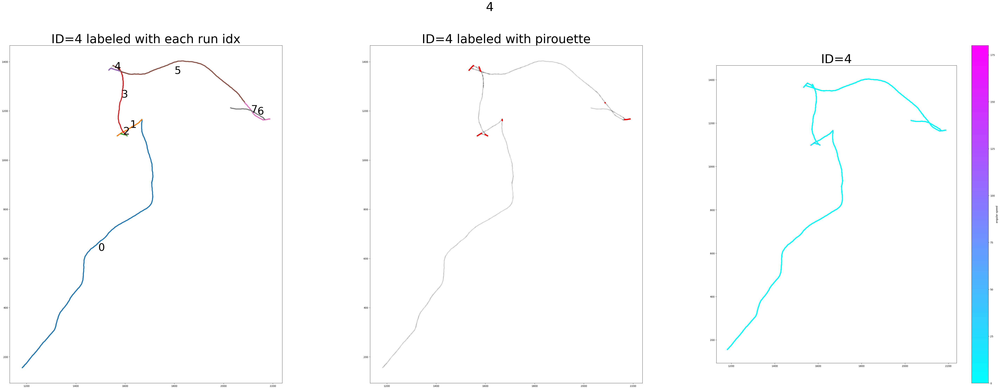

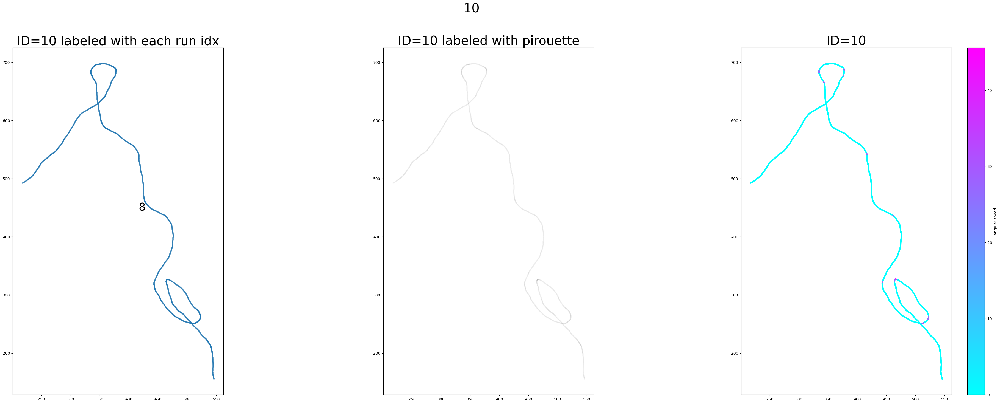

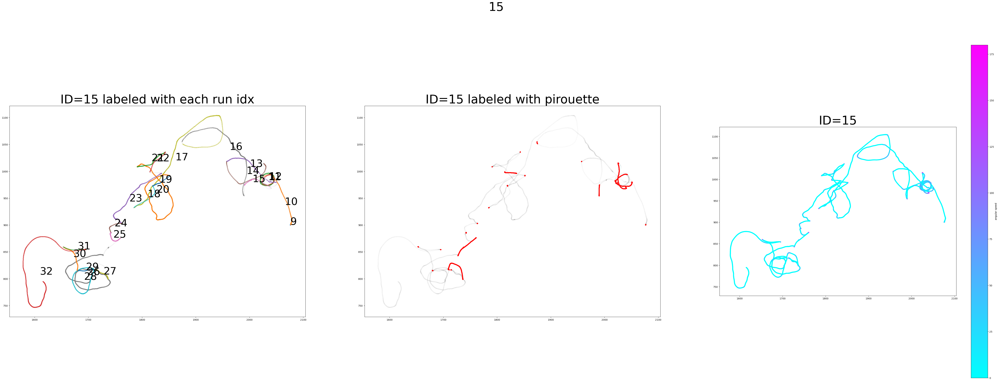

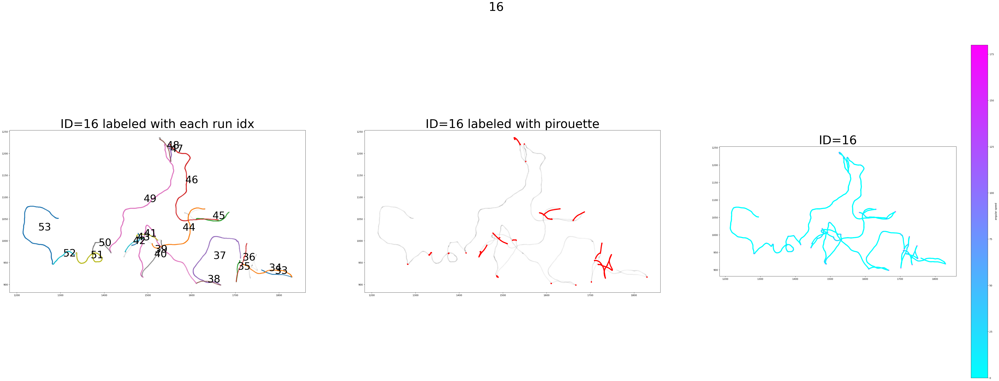

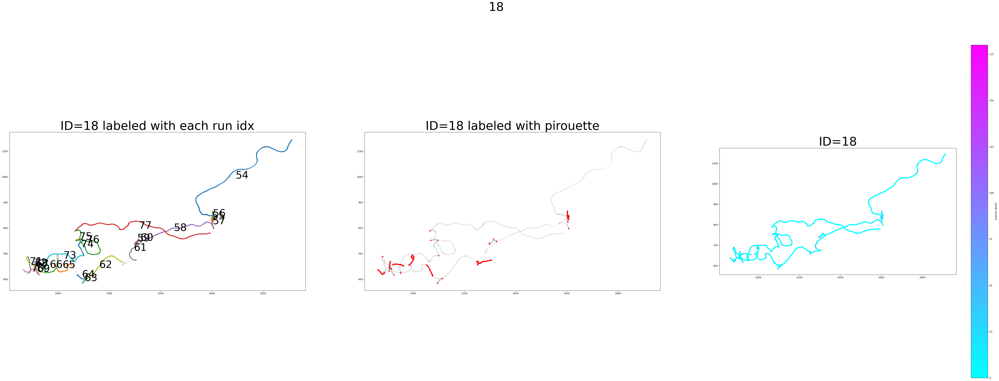

...

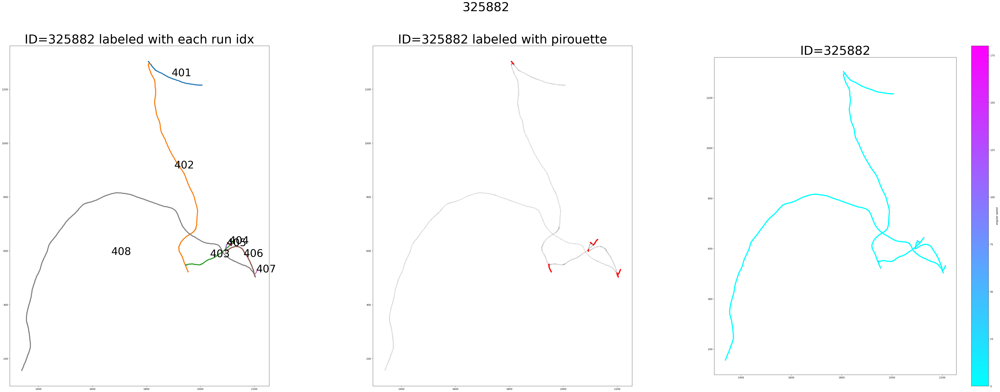

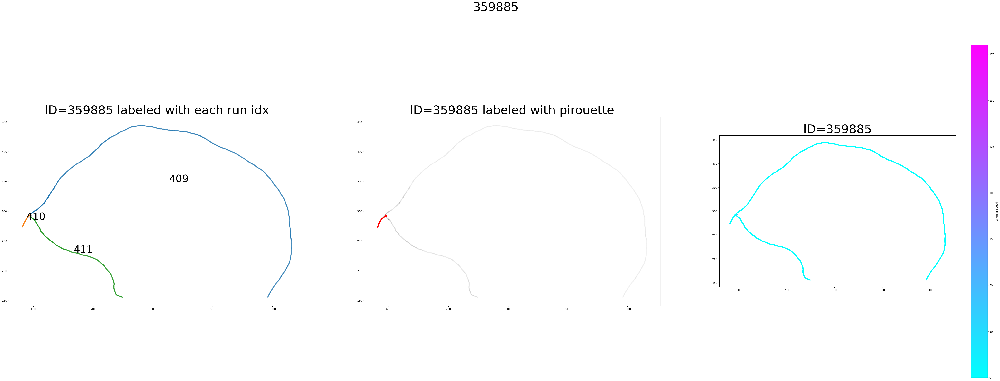

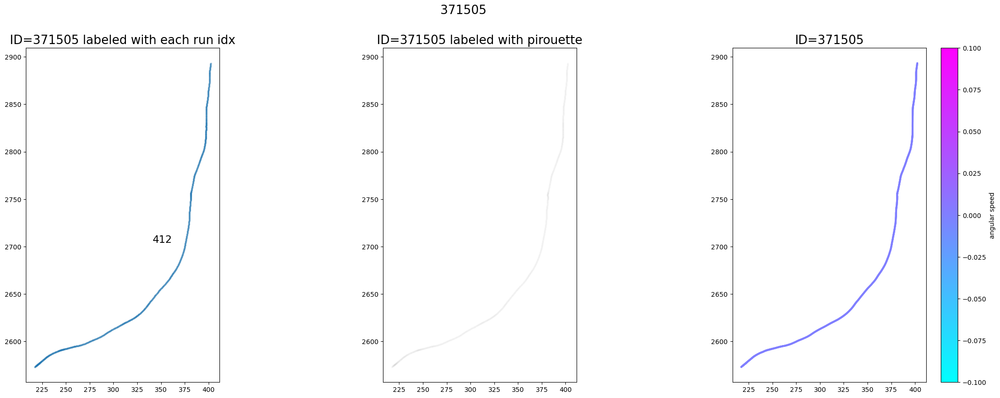

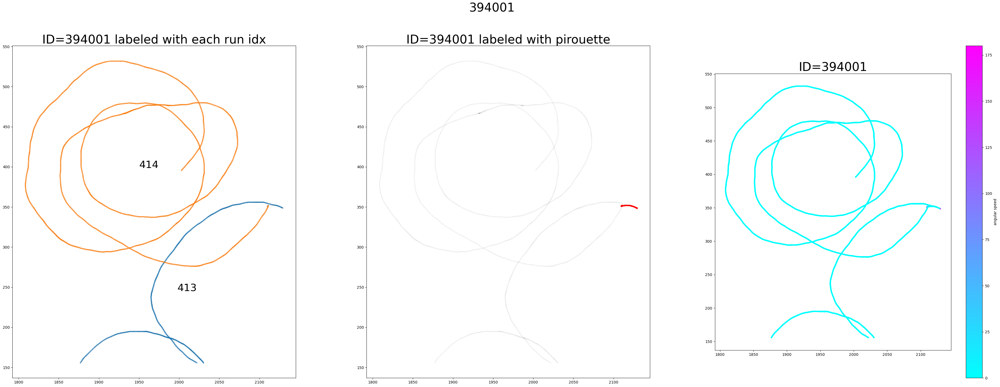

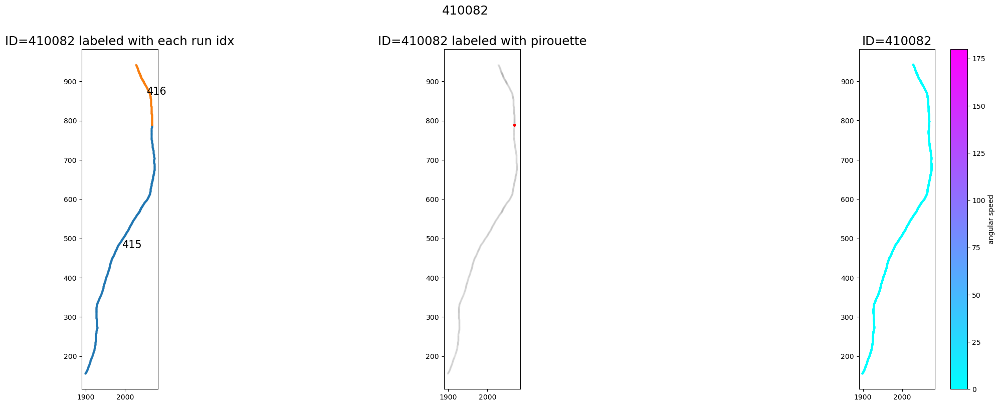

In [125]:
# # 可视化验证标记run并保存图片
# new_folder = 0
# # new_folder = r'Z:\data space+\C. elegans chemotaxis\20241103_turning_analysis\label_run_idx'
# for g_id, g_df in df_label_run.groupby('ID'):
    
#     df_id = df[df.ID==g_id]
    
#     # 根据数据大小设置图片尺寸
#     x_range = g_df.X.max()-g_df.X.min()
#     # 计算合适的宽度和高度，基础尺寸设为 (6, 4)，然后根据点的数量放大
#     base_size = (15, 5)
#     base_fs = 10
#     base_s = 2
#     scale_factor = min(max(x_range / 100, 1), 5)  # 设置缩放因子限制在1到3倍之间
#     scale_s = base_s*scale_factor
#     figsize = (base_size[0] * scale_factor, base_size[1] * scale_factor)
#     fig, ax = plt.subplots(1,3, figsize=figsize)
#     plt.suptitle(g_id, fontsize=base_fs*scale_factor, y = 0.98)
#     ax[1].scatter(df_id.X, df_id.Y, s=scale_s, c = 'grey', alpha=0.01)
#     ax[1].scatter(df_id[df_id.Pirouette==1].X, df_id[df_id.Pirouette==1].Y, s=scale_s, c = 'r', alpha=1)
#     ax[1].set_aspect('equal')
#     ax[1].set_title(f'ID={g_id} labeled with pirouette', fontsize=base_fs*scale_factor)
    
#     ax3 = ax[2].scatter(df_id.X, df_id.Y, s=scale_s, c = df_id.agl_speed, cmap='cool', alpha=1)
#     fig.colorbar(ax3, ax=ax[2], label='angular speed')
# #     ax[2].scatter(df_id[df_id.Pirouette==1].X, df_id[df_id.Pirouette==1].Y, s=scale_s, c = 'r', alpha=1)
#     ax[2].set_aspect('equal')
#     ax[2].set_title(f'ID={g_id}', fontsize=base_fs*scale_factor)
    
#     ax[0].set_title(f'ID={g_id} labeled with each run idx', fontsize=base_fs*scale_factor)
#     ax[0].scatter(g_df.X, g_df.Y, s=scale_s, c = 'grey', alpha=0.01)
#     ax[0].set_aspect('equal')
#     g_df = g_df.dropna(subset='RunID')
#     for r_id, df_r_id in g_df.groupby('RunID'):
#         ax[0].scatter(df_r_id.X, df_r_id.Y, s=scale_s, alpha=0.2)
#         ax[0].text(df_r_id.X.mean(), df_r_id.Y.mean(), s=str(int(r_id)), c='k', fontsize=base_fs*scale_factor*0.85)
#     if new_folder:
#     #  保存图片
#         title_name = f'ID{g_id}_run_and_pirouettes.png'
#         file_path = os.path.join(new_folder, title_name)
#         plt.savefig(file_path,bbox_inches='tight')
#     else:
#         plt.show()

11000 12000


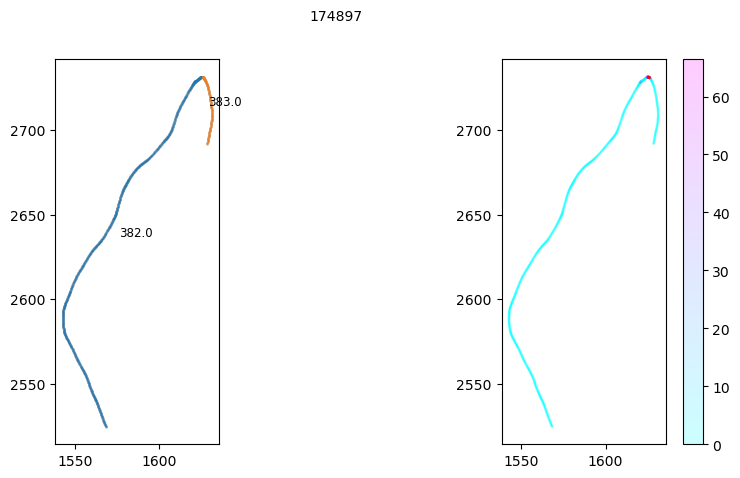

In [124]:
# # 选择id可视化
# g_id = 174897
# g_df = df_label_run[df_label_run.ID==g_id].reset_index(drop=True).loc[11000:12000]
# print(g_df.index.min(),g_df.index.max() )
# df_id = df[df.ID==g_id].reset_index(drop=True).loc[11000:12000]

# # 根据数据大小设置图片尺寸
# x_range = g_df.X.max()-g_df.X.min()
# # 计算合适的宽度和高度，基础尺寸设为 (6, 4)，然后根据点的数量放大
# base_size = (10, 5)
# base_fs = 10
# base_s = 1
# scale_factor = min(max(x_range / 100, 1), 5)  # 设置缩放因子限制在1到3倍之间
# scale_s = base_s*scale_factor
# figsize = (base_size[0] * scale_factor, base_size[1] * scale_factor)
# fig, ax = plt.subplots(1,2, figsize=figsize)
# plt.suptitle(g_id, fontsize=base_fs*scale_factor)
# ax2 = ax[1].scatter(df_id.X, df_id.Y, s=scale_s, c =df_id.agl_speed,cmap='cool', alpha=0.2)
# fig.colorbar(ax2, ax=ax[1])
# ax[1].scatter(df_id[df_id.Pirouette==1].X, df_id[df_id.Pirouette==1].Y, s=scale_s, c = 'r', alpha=1)
# ax[1].set_aspect('equal')

# ax[0].scatter(g_df.X, g_df.Y, s=scale_s, c = 'grey', alpha=0.2)
# ax[0].set_aspect('equal')
# g_df = g_df.dropna(subset='RunID')
# for r_id, df_r_id in g_df.groupby('RunID'):
#     ax[0].scatter(df_r_id.X, df_r_id.Y, s=scale_s, alpha=0.2)
#     ax[0].text(df_r_id.X.mean(), df_r_id.Y.mean(), s=str(r_id), c='k', fontsize=base_fs*scale_factor*0.85)
# plt.show()

## TurningRate随时间分布

In [ ]:

df = df_1024.copy()
conds = conds_1028
color_map = 'plasma'
time_len = 1.5     # h
time_inv = 5       # min
ls = 15
fs = 15
lw = 2
angle = 45
lines  =['solid', 'dotted', 'dashed', 'dashdot']
frame_length = 0.025  # mm

# 灵活设置时间间隔
num_frames = time_len*3600*frame_rate
periods = np.arange(0,time_len*60+1,time_inv)
periods_timestamp = np.arange(0, num_frames+1, time_inv*60*frame_rate)
labels = [(periods[i] + periods[i + 1]) / 2 for i in range(len(periods) - 1)]
df['Period_label'] = pd.cut(df['Timestamp'], bins=periods_timestamp, labels=labels, right=False,include_lowest=True)   # right=False表示区间左闭右开

# 设置颜色字典
color_dict = {}
if color_dict:
    pass
else:
    color_vec_norm = np.linspace(0.001,0.999,len(conds)+1)
    colormap = mpl.colormaps[color_map]
    colors  = colormap(color_vec_norm)
    color_dict = {}
    for i, d in enumerate(conds):
        color_dict[d] = colors[i]
        
fig,ax = plt.subplots(1,1, figsize = (8,6))        # (7,6) or(6,8)

for j in range(len(conds)):
    df_cond = df[df['Condition']==conds[j]]
    # 根据时间段画出平均速度，平均角速率，距圆心距离，CTX的分布(柱状图)
    df_mean_gby_prd_g = df_cond.groupby(['Period_label','Group_id']).agg({'Disp_to_mid':'mean'}).reset_index()
    # 在这一步代码中，agg mean中会自动排除nan值计算剩下值得均值，如果所有重复组都为nan值，则计算完也是nan值
    mean_gby_period = df_mean_gby_prd_g.groupby('Period_label').agg({'Disp_to_mid':'mean'}).reset_index()
    std_gb_period = df_mean_gby_prd_g.groupby('Period_label').agg({'Disp_to_mid':'sem'}).reset_index()
    
    mean_gby_period.loc[:,'Disp_to_mid'] = mean_gby_period['Disp_to_mid']*frame_length
    std_gb_period.loc[:,'Disp_to_mid'] = std_gb_period['Disp_to_mid']*frame_length
#     print(std_gb_period)
    # 判断，将出现nan值的组进行裁剪
    if mean_gby_period['Disp_to_mid'].isna().all():   # 如果所有都是nan值
        first_nan_index = mean_gby_period['Disp_to_mid'].first_valid_index() 
    elif ~mean_gby_period['Disp_to_mid'].isna().any():#如果没有nan值
        first_nan_index = mean_gby_period.index.max()
    else:
        # 返回第一个nan值得索引
        first_nan_index = mean_gby_period['Disp_to_mid'].isna().idxmax()
    if not np.isnan(first_nan_index):
        mean_gby_period = mean_gby_period.iloc[:first_nan_index]
        std_gb_period = std_gb_period.iloc[:first_nan_index]

    # 距离中心的位移
    ax.errorbar(mean_gby_period['Period_label'], mean_gby_period['Disp_to_mid'], yerr = std_gb_period['Disp_to_mid'],fmt = 'None', ecolor = color_dict[conds[j]], capsize = 2,alpha=0.4, linewidth = lw)
    ax.plot(mean_gby_period['Period_label'], mean_gby_period['Disp_to_mid'], color = color_dict[conds[j]], marker = 'o',markersize = 2.5, label = str(conds[j]), linewidth = lw)
plt.title('Mean displacement to midline\n across time', fontsize = fs)
plt.xlabel('Time(min)', fontsize=fs)
plt.ylabel('Displacement(mm)', fontsize=fs)
plt.tick_params(labelsize = fs*0.85)
plt.grid(color = 'grey', linestyle = 'dashed', alpha=0.4, axis='y')
plt.legend(bbox_to_anchor = (1.02,0.95), fontsize=fs*0.75)
plt.show()  